Please note that we developed our project based on a dedicated server with multiple GPUs. Please adjust the system and cuda setting here accordingly to run it in your environment.

The weights for all the model we trained can be found at :
https://drive.google.com/drive/folders/1kjVKwdP1bcS025DknuYj9znoZguvy2XF?usp=sharing

In [1]:
import torchvision
# import torchvision.transforms as transforms
from torchvision import datasets, transforms
from torchvision.models import vision_transformer
from torch.utils.data import DataLoader,random_split
from torch import nn, optim
import torch.nn.functional as F
import torch
import numpy as np
from tqdm import tqdm
import torchvision.models as models
import random
import matplotlib as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from ultralytics import YOLO
import os,sys,re,math,datetime,time,globe,random
import cv2
# please adjust this setting accordingly for your environment
os.environ["CUDA_VISIBLE_DEVICES"] = "0"
import pandas as pd
import moviepy.editor as moviepy

c:\Users\Ningxin Cynthia Li\anaconda3\envs\MIE\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
## The following fucntions are for cyclist bounding box detection approach described
## in section 1.2.2 Object Detection.

from scipy.optimize import linear_sum_assignment

# This function takes the bounding box and returns the center's coordinate
def get_bbox_center(bbox):
    print(bbox)
    x_center = (bbox[0] + bbox[2]) / 2
    y_center = (bbox[1] + bbox[3]) / 2
    return np.array([x_center, y_center])

# This method take two bouding boxes then calcualte the euc distance of them
def get_bboxPair_dist(bboxA, bboxB, metric="euc"):
    center_bboxA, center_bboxB = get_bbox_center(bboxA), get_bbox_center(bboxB)
    if metric=="euc":
        return np.linalg.norm(center_bboxA - center_bboxB)

# This method takes the two bouding boxes and calcualte their overlapping area
def get_bboxPair_overlap_area(bboxA, bboxB):
    xA = max(bboxA[0], bboxB[0]) # x1
    yA = max(bboxA[1], bboxB[1]) # y1
    xB = min(bboxA[2], bboxB[2]) # x2
    yB = min(bboxA[3], bboxB[3]) # y2
    interArea = max(0, xB - xA) * max(0, yB - yA)
    return interArea


# This function takes in the list of person bouding box and a list of bike bouding
# boxes, then prepare the pairwise cost matrix based on objective we proposed.
def prepare_cost_matrix(person_bbox_list, bike_bbox_list):
    num_persons = len(person_bbox_list)
    num_bikes = len(bike_bbox_list)
    cost_matrix = np.zeros((num_persons, num_bikes))
    # iteraet over all the person and bike bbox to get the cost matrix
    for i, person in enumerate(person_bbox_list):
        for j, bike in enumerate(bike_bbox_list):
            dist = get_bboxPair_dist(person['xyxy'], bike['xyxy'])
            overlap = get_bboxPair_overlap_area(person['xyxy'], bike['xyxy'])
            # here convert the bi-obj optimization into one cost function, that is
            # to find the combo of human and bike objs that have the largest overlapping
            # area and the least center distance
            cost_matrix[i, j] = dist - overlap  # min distance and max overlapping

    return cost_matrix

# This function takes the bounding box list of person and bike and returns the
# best combination based on our objective function, the returned bouding boxes are
# identifyed as bounding box of cyclist
def match_and_merge(person_bbox_list, bike_bbox_list):
    """
    Find the combo that has the min cost, then merge that combo into on obj, also
    we increase the size of the bbox accordingly to cover the person and the bike
    """
    cost_matrix = prepare_cost_matrix(person_bbox_list, bike_bbox_list)
    row_ind, col_ind = linear_sum_assignment(cost_matrix)

    merged_bbox_ind=0
    matched_pairs = []
    for i, j in zip(row_ind, col_ind):
        person = person_bbox_list[i]['xyxy']
        bike = bike_bbox_list[j]['xyxy']
        # note that here we use the xyxy format from yolo
        merged_box = [
            min(person[0], bike[0]),
            min(person[1], bike[1]),
            max(person[2], bike[2]),
            max(person[3], bike[3])
        ]
        matched_pairs.append({'bbox_id':merged_bbox_ind,
                              'person': i,
                              'bike': j,
                              'merged_box': merged_box})
        merged_bbox_ind+=1
    return matched_pairs

"""
Function that takes in a video and then extract n frames, for each frame we apply
our yolo model to process and then return the processed annotated images, videos,
and cropped bboxes of potential cyclists.
"""
def yolo_process_video(data_home_dir, img_out_dir, vid_in_dir, model, cls, yolo_imgsz=640, out_fps=3,vid_out_dir=None):

    vid_in_name,vid_in_ext = os.path.splitext(os.path.basename(vid_in_dir))

    # load video and start recieving output
    cap = cv2.VideoCapture(vid_in_dir)
    print(f"{cap.isOpened()}")
    # get specs of video
    fps = cap.get(cv2.CAP_PROP_FPS)
    # print("here")
    frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    # extract part of the frames only to save computation and storage
    skip_frames = int(fps / out_fps)
    ## output to mp4
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    vid_out_dir = os.path.join(img_out_dir ,vid_in_name) # output video to same folder as frames
    os.makedirs(vid_out_dir, exist_ok=True)
    video_out = cv2.VideoWriter(os.path.join(vid_out_dir,f'res_{vid_in_name}{vid_in_ext}'), fourcc, out_fps, (frame_width, frame_height))

    #### process each iamge with yolo
    frame_id = 0
    while cap.isOpened():
        ret,frame = cap.read()
        # print("cap ret frame read")
        if ret:
            # skip frames
            if frame_id % skip_frames == 0:
                frame_rgb = frame # cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
                # save curr frame
                # inference
                results = model([frame_rgb], imgsz=yolo_imgsz, verbose=False)
                #
                # #
                for img_index, result in enumerate(results):
                    frame_folder_dir  = f'{vid_in_name}/res_img_{img_index}_frame_{frame_id}'
                    frame_output_filename = f'{cls}_res_yolo_vid_{vid_in_name}_img_{img_index}_fid_{frame_id}.jpg'
                    frame_folder_dir = os.path.join(img_out_dir, frame_folder_dir)
                    os.makedirs(frame_folder_dir, exist_ok=True)

                    # save yolo annoated result
                    result.save(filename=f"{frame_folder_dir}/{frame_output_filename}")
                    result_array = result.plot(labels=False, probs=False, boxes=False)
                    # retireve all the bbox predicted by yolo, here, only classes labeled as human or bike are gathered
                    # these resultes are stored in a dict which will then be further processed
                    person_bbox_list, bike_bbox_list = [],[]
                    bbox_cls_dict = result.names
                    boxes_labs = result.boxes.cls.tolist()
                    boxes_conf = result.boxes.conf.tolist()
                    for box_id, (box, box_label, box_conf) in enumerate(zip(result.boxes.xyxy, boxes_labs,boxes_conf)):
                        bbox_path=f"{frame_folder_dir}/box_id_{box_id}_{bbox_cls_dict[box_label]}.jpg"
                        x1,y1,x2,y2 = [int(_) for _ in box.tolist()]
                        x1, y1 = max(x1, 0), max(y1, 0)
                        x2, y2 = min(x2, frame_width), min(y2, frame_height)
                        # print(x1,y1,x2,y2)
                        # cropped_img = frame_rgb[y1:y2, x1:x2]
                        # cv2.imwrite(bbox_path, cropped_img)
                        # store the current bounding box
                        if box_label==0:
                            person_bbox_list.append({"bbox_ind":box_id, "conf":box_conf, "xyxy":[x1,y1,x2,y2]})
                        if box_label==1:
                            bike_bbox_list.append({"bbox_ind":box_id, "conf":box_conf, "xyxy":[x1,y1,x2,y2]})


                    # for each image label out the merged person and bike bounding box
                    person_bike_merged_bbox_list = match_and_merge(person_bbox_list, bike_bbox_list)
                    for pb_bbox_ind, pb_bbox in enumerate(person_bike_merged_bbox_list):
                        pb_bbox_path=f"{frame_folder_dir}/{cls}_res_cropbp_vid_{vid_in_name}_img_{img_index}_fid_{frame_id}_bbox_{pb_bbox_ind}.jpg"
                        x1,y1,x2,y2 = pb_bbox['merged_box']
                        label=f"{cls}_bike_person"
                        cv2.rectangle(result_array, (x1, y1), (x2, y2), (0, 255, 0), 2)
                        # Put the label near the rectangle
                        cv2.putText(result_array, label, (x1, max(y1 - 10, 0)), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
                        # save boxes to local
                        pb_bbox_img = result_array[y1:y2, x1:x2]
                        cv2.imwrite(pb_bbox_path, pb_bbox_img)


                    video_out.write(result_array) # f'{cls}_res_img_{img_index}_fid_{frame_id}.jpg'
                    cv2.imwrite(f"{frame_folder_dir}/{cls}_res_yolobp_vid_{vid_in_name}_img_{img_index}_fid_{frame_id}.jpg", result_array)

            frame_id += 1
        else:
            break

    # print("here end")
    cap.release()
    video_out.release()

In [ ]:
# This part of code is to generate data of cropped bouding boxes of human and bike
# to finetune the classifier. In our dataset, we have scence with ride, unride and
# mixed. Ride videos are videos that most of its scences are cyclists in riding status.
# While unride videos are videos that most of its scences are cyclists in unriding status.
# We use this method to gather cropped iamges mainly for unride class.
# Please refer to section 1.2.2 Object Detection for more details.

model = YOLO('./model/yolov8m.pt')
#
cls_list=['ride', 'unride', 'mixed']
# cls=cls_list[0]
for cls in cls_list:
    task_name = "bike_data"
    data_home_dir="/home/yuliang/1517_proj/ultralytics/datasets"
    img_out_dir=f"/home/yuliang/1517_proj/ultralytics/datasets/processed_data/{task_name}_img/{cls}"
    vid_out_dir=f"/home/yuliang/1517_proj/ultralytics/datasets/processed_data/{task_name}_vid/{cls}"
    os.makedirs(img_out_dir, exist_ok=True)
    os.makedirs(vid_out_dir, exist_ok=True)

    raw_data_dir = f"/home/yuliang/1517_proj/ultralytics/datasets/raw_data/{task_name}_vid/{cls}/"
    for file in os.listdir(raw_data_dir):
        if file.endswith('.mp4'):
            vid_in_dir = os.path.join(raw_data_dir, file)
            yolo_process_video(data_home_dir, img_out_dir, vid_in_dir, model=model, cls=cls, yolo_imgsz=640, out_fps=3)

In [ ]:
# We train yolo model with customized cyclist class with bouding box CDD datasets.

# import os
# os.environ["CUDA_VISIBLE_DEVICES"] = "1"

customized_yolo_model =YOLO('/home/yuliang/1517_proj/ultralytics/checkpoint/yolov8s.pt')
results = customized_yolo_model.train(data='/home/yuliang/1517_proj/ultralytics/datasets/cyclist.yaml',
                      epochs=200,
                      imgsz=640,
                      patience=30,
                      batch=64,
                      lr0=0.01,
                      lrf=0.01, # final lr = (lr0 * lrf)
                      weight_decay=5e-4,
                      dropout=0.1,
                      pretrained=True,
                      seed=0,
                      box=8.5,
                      device="cuda:1",
                      name="detect_s",
                      project="/home/yuliang/1517_proj/ultralytics/checkpoint/yolov8n")

# Import and Transform Images

In [2]:
from PIL import Image, ImageOps

class ResizeAndPad:
    def __init__(self, desired_size):
        self.desired_size = desired_size

    def __call__(self, img):
        # Resize the image to maintain aspect ratio with one side being 224
        aspect_ratio = img.width / img.height
        if img.width < img.height:  # Width is the smaller dimension
            new_width = self.desired_size
            new_height = int(self.desired_size / aspect_ratio)
        else:  # Height is the smaller dimension or they are equal
            new_height = self.desired_size
            new_width = int(self.desired_size * aspect_ratio)

        # Use Image.Resampling.LANCZOS for high-quality downsampling
        img = img.resize((new_width, new_height), Image.Resampling.LANCZOS)

        # Calculate padding
        delta_width = self.desired_size - new_width
        delta_height = self.desired_size - new_height
        padding = (delta_width // 2, delta_height // 2, delta_width - (delta_width // 2), delta_height - (delta_height // 2))

        # Pad the resized image
        img = ImageOps.expand(img, padding, fill=0)  # Fill is the color for padding, 0 means black

        return img


# Now integrate this into your transforms.Compose
transform = transforms.Compose([
    ResizeAndPad(224),  # Custom transform to resize and pad
    transforms.ToTensor()
])


In [3]:
from torchvision import datasets
# Base directory of your dataset
base_dir = 'F:/UT_MIE/MIE1517/Project/finallllll/finallllll'

# Load each dataset separately
train_dataset = datasets.ImageFolder(root=f'{base_dir}/train', transform=transform)
val_dataset = datasets.ImageFolder(root=f'{base_dir}/val', transform=transform)
test_dataset = datasets.ImageFolder(root=f'{base_dir}/test', transform=transform)

# Display the shape of each dataset
print(f"train: {len(train_dataset)}, val: {len(val_dataset)}, test: {len(test_dataset)}")

train: 7459, val: 1706, test: 1720


In [4]:
def count_labels_by_folder(datasets):
    # Initialize counters for each dataset
    counts = {
        'Train': {'ride': 0, 'unride': 0},
        'Validation': {'ride': 0, 'unride': 0},
        'Test': {'ride': 0, 'unride': 0}
    }

    for name, dataset in datasets.items():
        # Iterate through the images and labels in the ImageFolder
        for path, _ in dataset.imgs:
            if 'unride' in path:
                counts[name]['unride'] += 1
            elif 'ride' in path:
                counts[name]['ride'] += 1

    return counts

# Assuming train_dataset, val_dataset, and test_dataset are ImageFolder instances
datasets = {
    'Train': train_dataset,
    'Validation': val_dataset,
    'Test': test_dataset
}

# Count and print the labels
label_counts = count_labels_by_folder(datasets)
for dataset_name, counts in label_counts.items():
    print(f"{dataset_name}: Ride: {counts['ride']}, Unride: {counts['unride']}")

Train: Ride: 3754, Unride: 3705
Validation: Ride: 886, Unride: 820
Test: Ride: 876, Unride: 844


# Models without Pose

In [6]:
def show_misclassified_images(misclassified_samples, num_images=30):
    # Calculate the number of rows needed to display the images
    num_rows = num_images // 5 + (num_images % 5 > 0)
    fig, axes = plt.subplots(num_rows, 5, figsize=(20, num_rows * 4))  # Adjust the size as needed

    # Flatten the axes array for easy indexing
    axes = axes.flatten()

    for i, (image, label, pred) in enumerate(misclassified_samples[:num_images]):
        image_np = image.numpy().transpose((1, 2, 0))
        mean = np.array([0.485, 0.456, 0.406])
        std = np.array([0.229, 0.224, 0.225])
        image_np = std * image_np + mean  # Unnormalize
        image_np = np.clip(image_np, 0, 1)  # Clip values to be between 0 and 1

        ax = axes[i]
        ax.imshow(image_np)
        ax.set_title(f"Label: {int(label)}\nPred: {int(pred.squeeze().item())}", fontsize=10)
        ax.axis('off')

    # Hide any unused subplots if the number of images is not a multiple of 5
    for j in range(i + 1, num_rows * 5):
        axes[j].axis('off')

    plt.subplots_adjust(wspace=0.4, hspace=0.6)  # Adjust spacing between images
    plt.show()

In [7]:
def set_seed(seed_value=42, use_cuda=True):
    random.seed(seed_value)
    np.random.seed(seed_value)
    torch.manual_seed(seed_value)
    if use_cuda and torch.cuda.is_available():
        torch.cuda.manual_seed(seed_value)
        torch.cuda.manual_seed_all(seed_value)

In [8]:
# Function that train the model
from sklearn.metrics import f1_score, precision_score, recall_score, confusion_matrix

def train_model(train_dataset, val_dataset, model, num_epochs, bsz, lr, patience,
                weight_decay=0, use_gpu=True, plot_=False, confusion = True, misclass = True):
    set_seed()
    #
    device = torch.device("cuda" if torch.cuda.is_available() and use_gpu else "cpu")
    print(f"curr device: {device}")

    # prepare data loader
    train_loader = DataLoader(train_dataset, batch_size=bsz, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=bsz, shuffle=False)
    # data parallel
    # model.to(device)
    # loss function and optimizer
    criterion = nn.BCEWithLogitsLoss()
    optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)
    #
    # early stop
    best_val_loss = float('inf')
    epochs_no_improve=0

    # stats
    train_corr_list = np.full(num_epochs, np.nan)
    train_loss_list = np.full(num_epochs, np.nan)
    val_corr_list = np.full(num_epochs, np.nan)
    val_loss_list = np.full(num_epochs, np.nan)
    train_f1_list = np.full(num_epochs, np.nan)
    val_f1_list = np.full(num_epochs, np.nan)
    train_precision_list = np.full(num_epochs, np.nan)
    train_recall_list = np.full(num_epochs, np.nan)
    val_precision_list = np.full(num_epochs, np.nan)
    val_recall_list = np.full(num_epochs, np.nan)

    best_acc_epoch = 0  # Track the epoch with the highest validation accuracy
    best_val_accuracy = 0

    # train loop
    for epoch in range(num_epochs):
        model.train()
        train_loss, train_correct = 0.0,0
        train_bsz, val_bsz = 0,0
        train_preds, train_labels_list = [], []
        with tqdm(enumerate(train_loader), total=len(train_loader), desc=f"Epoch {epoch+1}/{num_epochs}") as t:
            for batch_ind, (inputs, labels) in t:
                inputs, labels = inputs.to(device), labels.to(device)
                optimizer.zero_grad()
                # forward
                outputs = model(inputs)
                loss = criterion(outputs, labels.unsqueeze(1).float())
                # backward
                loss.backward()
                optimizer.step()
                # stats
                train_loss += loss.item()
                # for binary cls case\
                preds = torch.round(torch.sigmoid(outputs))  # Using sigmoid and rounding for binary classification
                train_correct += (preds.squeeze() == labels).sum().item()
                train_bsz += labels.size(0)

                # Collecting labels and predictions for metrics calculation
                train_labels_list.extend(labels.cpu().numpy())
                train_preds.extend(preds.squeeze().detach().cpu().numpy())

        avg_train_acc = train_correct / train_bsz
        avg_train_loss = train_loss / len(train_loader)
        train_loss_list[epoch] = avg_train_loss
        train_corr_list[epoch] = avg_train_acc
        train_f1 = f1_score(train_labels_list, train_preds)
        train_f1_list[epoch] = train_f1
        train_precision = precision_score(train_labels_list, train_preds)
        train_precision_list[epoch] = train_precision
        train_recall = recall_score(train_labels_list, train_preds)
        train_recall_list[epoch] = train_recall


        # val per epoch
        val_labs, val_preds = [],[]
        #
        val_loss, val_correct = 0.0,0
        misclassified_samples = []

        model.eval()
        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)
                loss = criterion(outputs, labels.unsqueeze(1).float())
                val_loss += loss.item()

                # stats and confusion matrix
                # binary cls case
                preds = torch.round(torch.sigmoid(outputs))

                misclassified = (preds.squeeze(1) != labels)
                for i, mis in enumerate(misclassified):
                    if mis:
                        misclassified_samples.append((inputs[i].cpu(), labels[i].cpu(), preds[i].cpu()))

                # print(preds.shape, preds.squeeze(1))
                val_correct += (preds.squeeze(1) == labels).sum().item()
                val_bsz += labels.size(0)
                # prepare pres and labs for cf matrix
                val_labs.extend(labels.cpu().numpy())
                val_preds.extend(preds.squeeze(1).cpu().numpy())


        avg_val_acc = val_correct / val_bsz
        avg_val_loss = val_loss / len(val_loader)
        val_loss_list[epoch]=avg_val_loss
        val_corr_list[epoch] = avg_val_acc
        val_f1 = f1_score(val_labs, val_preds)
        val_f1_list[epoch] = val_f1
        val_precision = precision_score(val_labs, val_preds)
        val_precision_list[epoch] = val_precision
        val_recall = recall_score(val_labs, val_preds)
        val_recall_list[epoch] = val_recall

        ## log info
        print(f'epoch {epoch+1}/{num_epochs} | train | loss: {avg_train_loss:.6f}, acc: {avg_train_acc:.4f}, Precision: {train_precision:.4f}, Recall: {train_recall:.4f}, f1: {train_f1:.4f}')
        print(f'epoch {epoch+1}/{num_epochs} | val | loss: {avg_val_loss:.6f} acc: {avg_val_acc:.4f}, Precision: {val_precision:.4f}, Recall: {val_recall:.4f}, f1: {val_f1:.4f}')


        if avg_val_acc > best_val_accuracy:
            best_val_accuracy = avg_val_acc
            best_acc_epoch = epoch
            # Store labels and predictions for the best epoch
            best_val_labels_list = val_labs.copy()
            best_val_preds_list = val_preds.copy()

        ## early stop based on val dataset result
        # check if val loss improved
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            epochs_no_improve = 0
        else:
            epochs_no_improve += 1
            print(f"no improvement in val loss for {epochs_no_improve} epochs.")
            if epochs_no_improve == patience:
                    print(f"patient exceeded, early stop triggered at epoch {epoch}")
                    break
    print(f"\nBest val corr observed at {np.nanargmax(val_corr_list)+1}: {np.nanmax(val_corr_list)}")
    print(f"Best val loss observed at {np.nanargmin(val_loss_list)+1}: {np.nanmin(val_loss_list)}")
    print(f"Best val f1 observed at {np.nanargmax(val_f1_list)+1}: {np.nanmax(val_f1_list)}")

    if confusion == True:
        cm = confusion_matrix(best_val_labels_list, best_val_preds_list)
        plt.figure(figsize=(8, 6))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=[0, 1], yticklabels=[0, 1])
        plt.title(f'Confusion Matrix for Best Val Acc Epoch: {best_acc_epoch + 1}')
        plt.ylabel('True Label')
        plt.xlabel('Predicted Label')
        plt.show()

    if plot_ == True:
        # Generating the plot
        plt.figure(figsize=(10, 6))
        plt.plot(train_loss_list, label='train Loss')
        plt.plot(val_loss_list, label='val Loss')
        # Adding title and labels
        plt.title(f'loss for bsz:{bsz} epc:{epoch+1} lr:{lr}')
        plt.xlabel('Epochs')
        plt.ylabel('Loss')
        plt.legend()
        # Display the plot
        plt.show()
        # Generating the plot
        plt.figure(figsize=(10, 6))
        plt.plot(train_corr_list, label='train accr')
        plt.plot(val_corr_list, label='val accr')
        # Adding title and labels
        plt.title(f'accr for bsz:{bsz} epc:{epoch+1} lr:{lr}')
        plt.xlabel('Epochs')
        plt.ylabel('Accr')
        plt.legend()
        # Display the plot
        plt.show()

    if misclass == True:
        show_misclassified_images(misclassified_samples)

## Simple CNN

In [9]:
class SimpleCNN(nn.Module):
    def __init__(self):
        super(SimpleCNN, self).__init__()
        
        self.conv1 = nn.Conv2d(3, 32, kernel_size=3, stride=1, padding=1)  # Input channels = 3 (RGB)
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2, padding=0)  # Pooling layer
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
        self.conv3 = nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1)
        self.fc1 = nn.Linear(128 * 28 * 28, 512)  # Adjust the input size accordingly
        self.fc2 = nn.Linear(512, 1)  # Output layer for binary classification
        
    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))  # 224x224x3 -> 112x112x32
        x = self.pool(F.relu(self.conv2(x)))  # 112x112x32 -> 56x56x64
        x = self.pool(F.relu(self.conv3(x)))  # 56x56x64 -> 28x28x128
        
        x = x.view(-1, 128 * 28 * 28)  # Flatten the output for the dense layer
        x = F.relu(self.fc1(x))
        x = self.fc2(x)  # Sigmoid activation for binary classification
        return x

curr device: cuda


Epoch 1/10:   0%|          | 0/117 [00:00<?, ?it/s]

Epoch 1/10: 100%|██████████| 117/117 [00:19<00:00,  5.91it/s]


epoch 1/10 | train | loss: 0.388526, acc: 0.8271, Precision: 0.8243, Recall: 0.8283, f1: 0.8263
epoch 1/10 | val | loss: 0.830511 acc: 0.5645, Precision: 0.5412, Recall: 0.6171, f1: 0.5766


Epoch 2/10: 100%|██████████| 117/117 [00:20<00:00,  5.78it/s]


epoch 2/10 | train | loss: 0.190276, acc: 0.9218, Precision: 0.9228, Recall: 0.9196, f1: 0.9212
epoch 2/10 | val | loss: 0.626220 acc: 0.7409, Precision: 0.6969, Recall: 0.8159, f1: 0.7517


Epoch 3/10: 100%|██████████| 117/117 [00:19<00:00,  5.85it/s]


epoch 3/10 | train | loss: 0.120016, acc: 0.9555, Precision: 0.9547, Recall: 0.9557, f1: 0.9552
epoch 3/10 | val | loss: 0.858931 acc: 0.6489, Precision: 0.5904, Recall: 0.8805, f1: 0.7068
no improvement in val loss for 1 epochs.


Epoch 4/10: 100%|██████████| 117/117 [00:20<00:00,  5.84it/s]


epoch 4/10 | train | loss: 0.073106, acc: 0.9736, Precision: 0.9710, Recall: 0.9760, f1: 0.9735
epoch 4/10 | val | loss: 1.174126 acc: 0.7034, Precision: 0.6337, Recall: 0.9073, f1: 0.7462
no improvement in val loss for 2 epochs.


Epoch 5/10: 100%|██████████| 117/117 [00:20<00:00,  5.83it/s]


epoch 5/10 | train | loss: 0.041030, acc: 0.9858, Precision: 0.9852, Recall: 0.9862, f1: 0.9857
epoch 5/10 | val | loss: 1.650471 acc: 0.6624, Precision: 0.5937, Recall: 0.9427, f1: 0.7286
no improvement in val loss for 3 epochs.
patient exceeded, early stop triggered at epoch 4

Best val corr observed at 2: 0.7409144196951934
Best val loss observed at 2: 0.6262204724329489
Best val f1 observed at 2: 0.751685393258427


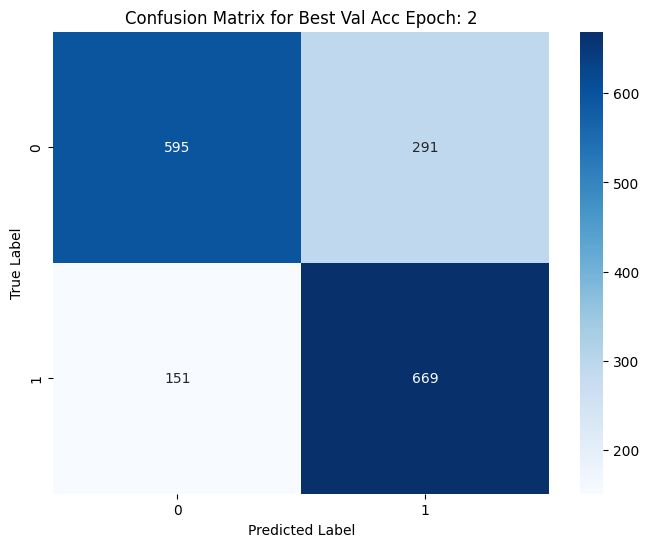

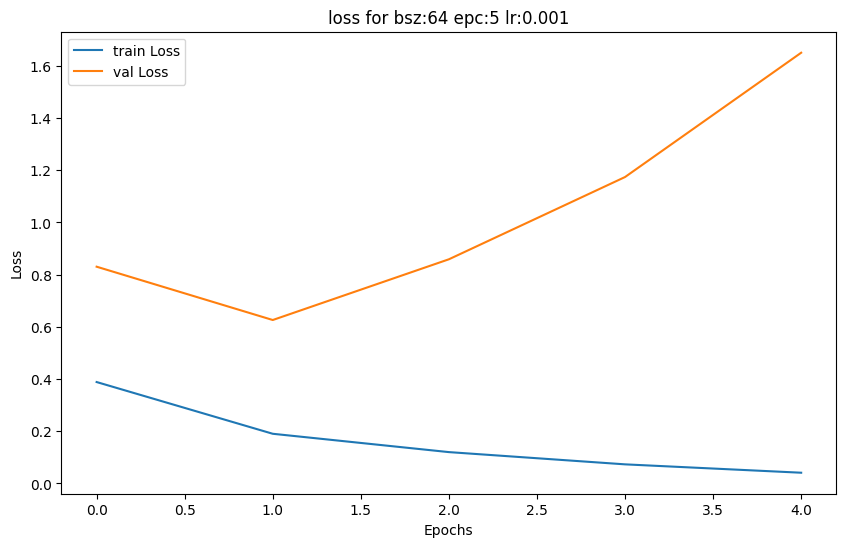

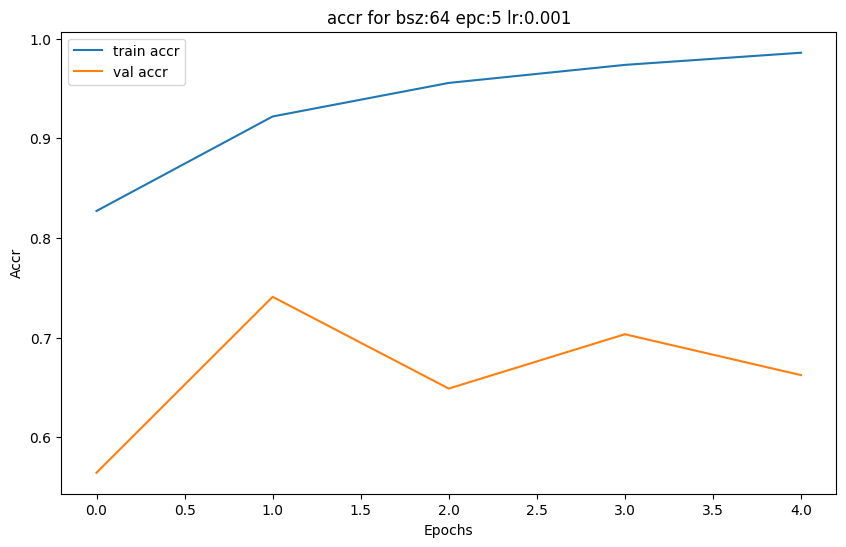

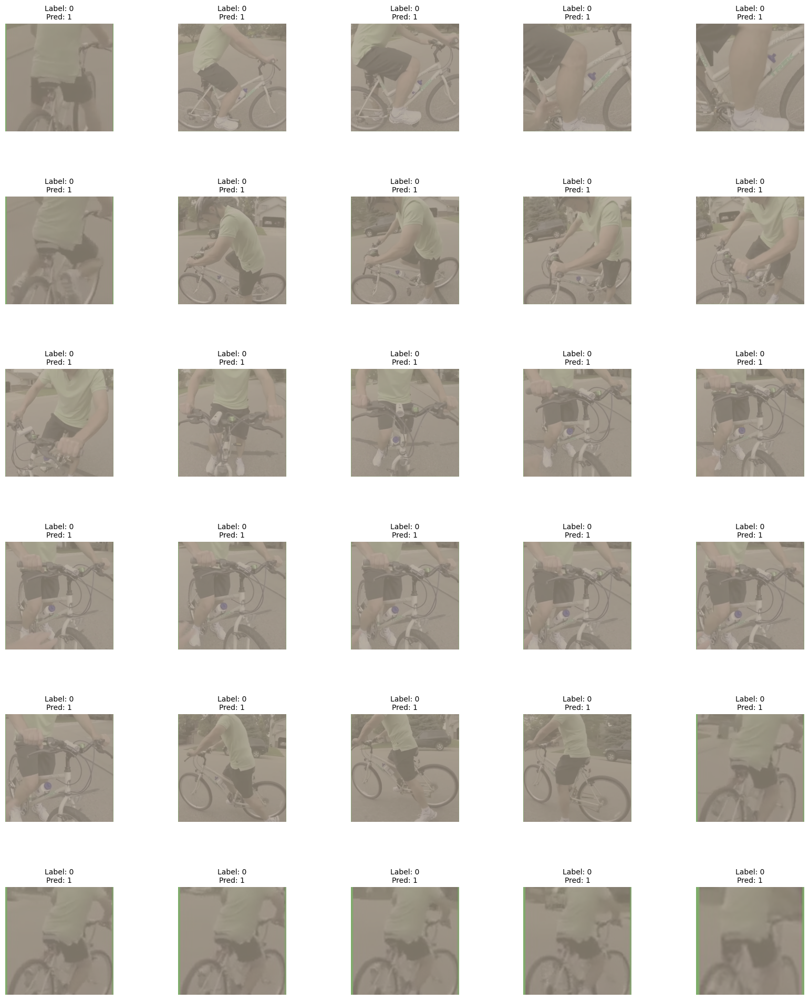

In [10]:
# Load a Simple CNN model
model = SimpleCNN()

# data parallel
# model = nn.DataParallel(model, device_ids=[0, 1])
model.to(torch.device("cuda"))

train_model(train_dataset=train_dataset,
            val_dataset=val_dataset,
            model=model,
            num_epochs=10,
            bsz=64,
            lr=0.001,
            patience=3,
            use_gpu=True,
            plot_=True)

## Resnet18

In [11]:
# Simple 2 layer MLP for classification
class mlp1(nn.Module):
    def __init__(self, input_dim, output_dim):
        super(mlp1, self).__init__()
        self.fc1 = nn.Linear(input_dim, 512)
        self.fc2 = nn.Linear(512, output_dim)

    def forward(self, x):
        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        return x

c:\Users\Ningxin Cynthia Li\anaconda3\envs\MIE\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


curr device: cuda


Epoch 1/10:   0%|          | 0/117 [00:00<?, ?it/s]

Epoch 1/10: 100%|██████████| 117/117 [00:40<00:00,  2.89it/s]


epoch 1/10 | train | loss: 0.143273, acc: 0.9424, Precision: 0.9368, Recall: 0.9479, f1: 0.9423
epoch 1/10 | val | loss: 1.501881 acc: 0.6606, Precision: 0.8801, Recall: 0.3402, f1: 0.4908


Epoch 2/10: 100%|██████████| 117/117 [00:22<00:00,  5.19it/s]


epoch 2/10 | train | loss: 0.071247, acc: 0.9745, Precision: 0.9731, Recall: 0.9757, f1: 0.9744
epoch 2/10 | val | loss: 0.442597 acc: 0.8089, Precision: 0.7446, Recall: 0.9171, f1: 0.8219


Epoch 3/10: 100%|██████████| 117/117 [00:21<00:00,  5.43it/s]


epoch 3/10 | train | loss: 0.051762, acc: 0.9819, Precision: 0.9796, Recall: 0.9841, f1: 0.9818
epoch 3/10 | val | loss: 1.380114 acc: 0.7298, Precision: 0.6410, Recall: 0.9951, f1: 0.7797
no improvement in val loss for 1 epochs.


Epoch 4/10: 100%|██████████| 117/117 [00:21<00:00,  5.46it/s]


epoch 4/10 | train | loss: 0.031905, acc: 0.9883, Precision: 0.9887, Recall: 0.9879, f1: 0.9883
epoch 4/10 | val | loss: 1.119219 acc: 0.6090, Precision: 0.6047, Recall: 0.5390, f1: 0.5700
no improvement in val loss for 2 epochs.


Epoch 5/10: 100%|██████████| 117/117 [00:21<00:00,  5.44it/s]


epoch 5/10 | train | loss: 0.026367, acc: 0.9916, Precision: 0.9895, Recall: 0.9935, f1: 0.9915
epoch 5/10 | val | loss: 0.990562 acc: 0.7380, Precision: 0.6481, Recall: 0.9951, f1: 0.7850
no improvement in val loss for 3 epochs.
patient exceeded, early stop triggered at epoch 4

Best val corr observed at 2: 0.8089097303634232
Best val loss observed at 2: 0.44259713675947515
Best val f1 observed at 2: 0.8218579234972677


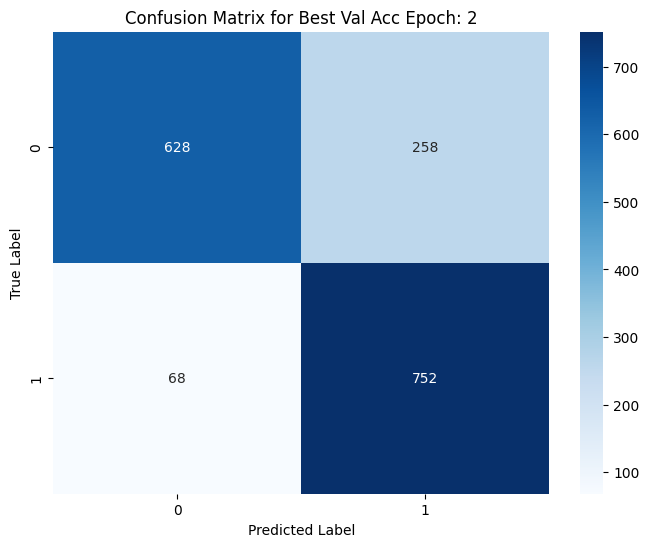

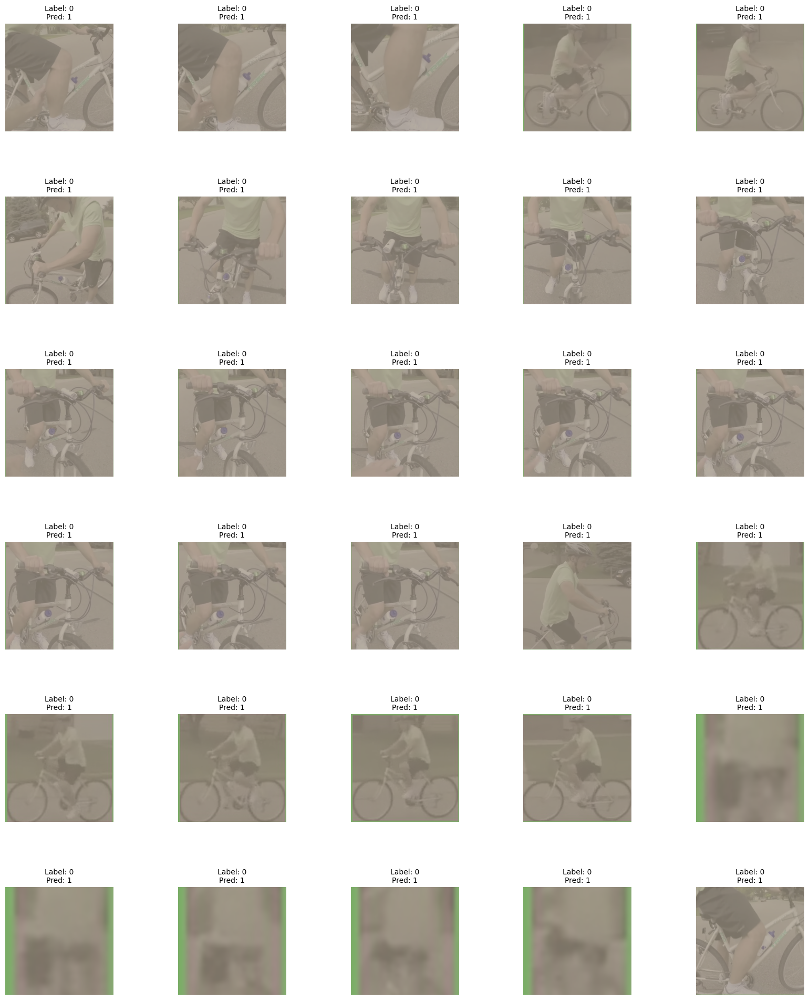

In [12]:
# Load a pre-trained ResNet18 model
model = models.resnet18(weights=True)
# Remove the fully connected layer
num_ftrs = model.fc.in_features
# Replace with MLP
model.fc = mlp1(num_ftrs, output_dim=1)

# data parallel
# model = nn.DataParallel(model, device_ids=[0, 1])
model.to(torch.device("cuda:0"))

train_model(train_dataset=train_dataset,
            val_dataset=val_dataset,
            model=model,
            num_epochs=10,
            bsz=64,
            lr=0.001,
            patience=3,
            use_gpu=True)

## SqueezeNet

c:\Users\Ningxin Cynthia Li\anaconda3\envs\MIE\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=SqueezeNet1_0_Weights.IMAGENET1K_V1`. You can also use `weights=SqueezeNet1_0_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


curr device: cuda


Epoch 1/10:   0%|          | 0/117 [00:00<?, ?it/s]

Epoch 1/10: 100%|██████████| 117/117 [00:20<00:00,  5.64it/s]


epoch 1/10 | train | loss: 0.451215, acc: 0.7874, Precision: 0.8150, Recall: 0.7398, f1: 0.7756
epoch 1/10 | val | loss: 0.679626 acc: 0.6366, Precision: 0.5949, Recall: 0.7646, f1: 0.6692


Epoch 2/10: 100%|██████████| 117/117 [00:20<00:00,  5.70it/s]


epoch 2/10 | train | loss: 0.325396, acc: 0.8614, Precision: 0.8748, Recall: 0.8413, f1: 0.8577
epoch 2/10 | val | loss: 0.850261 acc: 0.5985, Precision: 0.5758, Recall: 0.6256, f1: 0.5996
no improvement in val loss for 1 epochs.


Epoch 3/10: 100%|██████████| 117/117 [00:20<00:00,  5.74it/s]


epoch 3/10 | train | loss: 0.234465, acc: 0.9066, Precision: 0.9037, Recall: 0.9088, f1: 0.9062
epoch 3/10 | val | loss: 0.899804 acc: 0.6184, Precision: 0.6014, Recall: 0.6110, f1: 0.6062
no improvement in val loss for 2 epochs.


Epoch 4/10: 100%|██████████| 117/117 [00:20<00:00,  5.71it/s]


epoch 4/10 | train | loss: 0.187747, acc: 0.9264, Precision: 0.9183, Recall: 0.9350, f1: 0.9266
epoch 4/10 | val | loss: 1.412004 acc: 0.6512, Precision: 0.5856, Recall: 0.9390, f1: 0.7213
no improvement in val loss for 3 epochs.
patient exceeded, early stop triggered at epoch 3

Best val corr observed at 4: 0.6512309495896834
Best val loss observed at 1: 0.6796258886655172
Best val f1 observed at 4: 0.7213114754098361


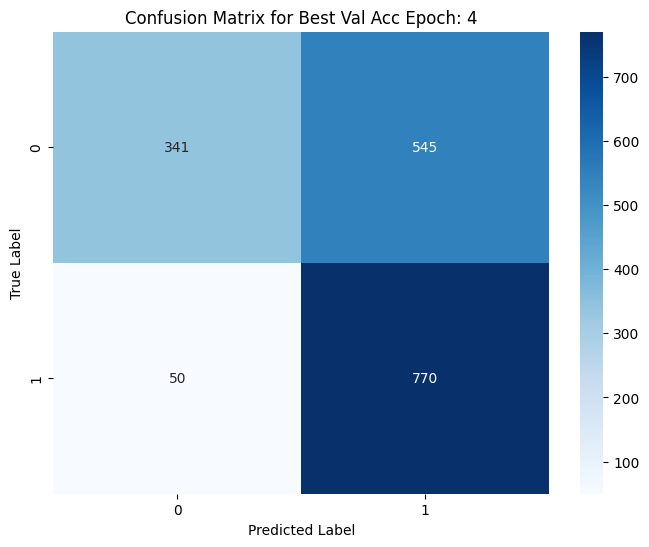

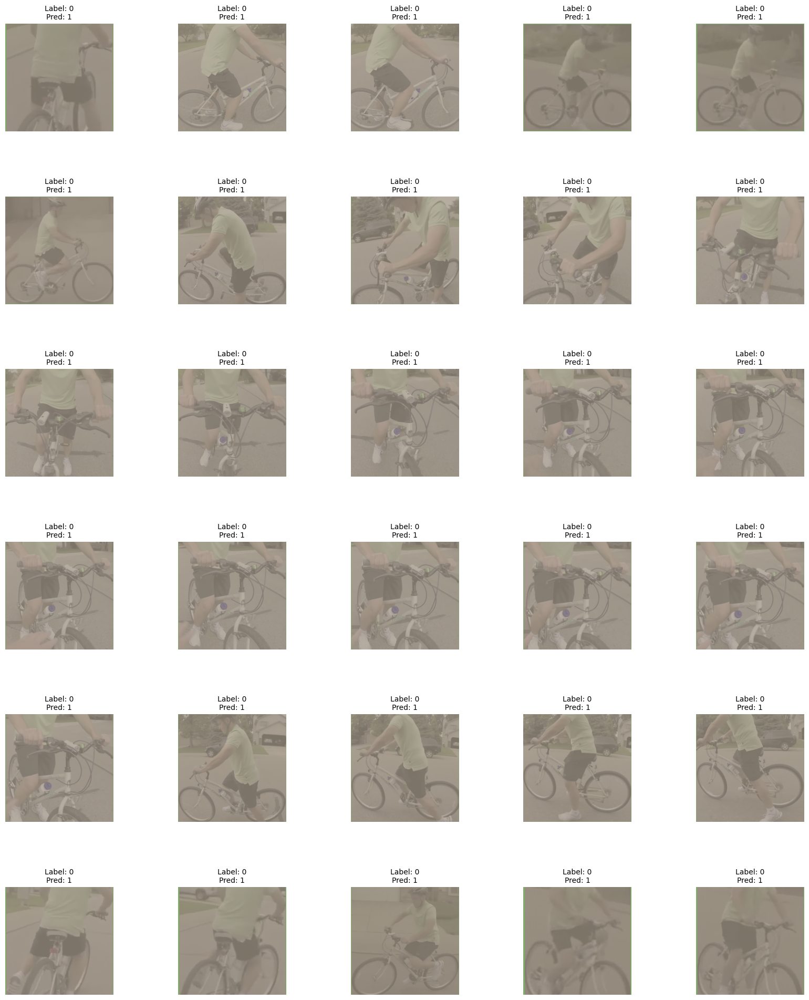

In [13]:
# Load a pre-trained SqueezeNet model
model = models.squeezenet1_0(weights=True)
model.classifier = nn.Sequential(
    nn.AdaptiveAvgPool2d(1),
    nn.Flatten(),
    mlp1(512, 1)
)

# data parallel
# model = nn.DataParallel(model, device_ids=[0, 1])
model.to(torch.device("cuda:0"))

train_model(train_dataset=train_dataset,
            val_dataset=val_dataset,
            model=model,
            num_epochs=10,
            bsz=64,
            lr=0.001,
            patience=3,
            use_gpu=True)

# PoseNetCNN
## PoseNet + simple CNN

In [28]:
class PoseNetCNN(nn.Module):
    def __init__(self, num_keypoints=17, num_classes=1, lrelu_tr=0.1):
        super(PoseNetCNN, self).__init__()
        self.name="PoseNetCNN"
        
        self.cnn = nn.Sequential(
            nn.Conv2d(3, 32, 3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, 2),  # 112x112x32
            nn.Conv2d(32, 64, 3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, 2),  # 56x56x64
            nn.Conv2d(64, 128, 3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, 2),  # 28x28x128
        )
        
        
        self.yoloMLP = nn.Sequential(
            nn.Linear(num_keypoints * 2, 128),  # 17 * 2 (x, y)
            nn.LeakyReLU(lrelu_tr),
            nn.Linear(128, 64),
            nn.LeakyReLU(lrelu_tr)
        )
        
        self.combinedMLP = nn.Sequential(
            nn.Linear(128 * 28 * 28 + 64, 1024),  
            nn.ReLU(),
            nn.Linear(1024, 256),
            nn.ReLU(),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.Linear(128, num_classes)
        )

    def forward(self, x, keypoints):
        # CNN
        x = self.cnn(x)
        x = torch.flatten(x, 1)  

        # yoloMLP
        keypoints = keypoints.view(keypoints.size(0), -1) #
        yoloMLP_out = self.yoloMLP(keypoints)
        
        # concat
        concat_features = torch.cat((x, yoloMLP_out), dim=1)
        #
        output = self.combinedMLP(concat_features)
        
        return output

In [15]:
def set_seed(seed_value=42, use_cuda=True):
    random.seed(seed_value)
    np.random.seed(seed_value)
    torch.manual_seed(seed_value)
    if use_cuda and torch.cuda.is_available():
        torch.cuda.manual_seed(seed_value)
        torch.cuda.manual_seed_all(seed_value)

In [16]:
# Function that train the model
from sklearn.metrics import f1_score, precision_score, recall_score, confusion_matrix
import copy

def train_PoseNetCNN(train_dataset, val_dataset, model, num_epochs, bsz, lr, patience,
                     weight_decay=0, use_gpu=True, plot_=False, PoseNetModel=None, 
                     confusion=True, misclass=True, model_dir=None):
    set_seed()

    if not os.path.exists(model_dir):
        os.makedirs(model_dir, exist_ok=True)

    device = torch.device("cuda" if torch.cuda.is_available() and use_gpu else "cpu")
    print(f"curr device: {device}")

    train_loader = DataLoader(train_dataset, batch_size=bsz, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=bsz, shuffle=False)

    criterion = nn.BCEWithLogitsLoss()
    optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)

    best_val_loss = float('inf')
    epochs_no_improve = 0

    train_corr_list = np.full(num_epochs, np.nan)
    train_loss_list = np.full(num_epochs, np.nan)
    val_corr_list = np.full(num_epochs, np.nan)
    val_loss_list = np.full(num_epochs, np.nan)

    # New metrics storage
    train_precision_list = np.full(num_epochs, np.nan)
    train_recall_list = np.full(num_epochs, np.nan)
    train_f1_list = np.full(num_epochs, np.nan)
    val_precision_list = np.full(num_epochs, np.nan)
    val_recall_list = np.full(num_epochs, np.nan)
    val_f1_list = np.full(num_epochs, np.nan)

    best_acc_epoch = 0  # Track the epoch with the highest validation accuracy
    best_val_accuracy = 0

    best_model_wts=None

    for epoch in range(num_epochs):
        model.train()
        train_loss, train_correct = 0.0, 0
        train_total, val_total = 0, 0
        train_preds, train_labels_list, val_preds, val_labels_list = [], [], [], []

        # Training loop
        with tqdm(enumerate(train_loader), total=len(train_loader), desc=f"Epoch {epoch+1}/{num_epochs}") as t:
            for batch_ind, (inputs, labels) in t:
                inputs, labels = inputs.to(device), labels.to(device)
                with torch.no_grad():
                    # Assuming PoseNetModel and necessary preprocessing are correctly defined
                    res = PoseNetModel(inputs, verbose=False)
                    res_keypoints = torch.stack([i.keypoints[0].xy if i.keypoints[0].conf!=None else torch.zeros(1,17,2).to(device) for i in res ]).squeeze(1)
                    mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1).to(device)
                    std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1).to(device)
                    inputs = (inputs - mean) / std


                optimizer.zero_grad()
                outputs = model(inputs, res_keypoints)
                loss = criterion(outputs, labels.unsqueeze(1).float())
                loss.backward()
                optimizer.step()

                train_loss += loss.item()
                preds = torch.round(torch.sigmoid(outputs))
                train_correct += (preds.squeeze() == labels).sum().item()
                train_total += labels.size(0)

                # Collecting labels and predictions for metrics calculation
                train_labels_list.extend(labels.cpu().numpy())
                train_preds.extend(preds.squeeze().detach().cpu().numpy())

        # Validation loop
        model.eval()
        val_loss, val_correct = 0.0, 0
        misclassified_samples = []
        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs, labels = inputs.to(device), labels.to(device)

                res = PoseNetModel(inputs, verbose=False)
                res_keypoints = torch.stack([i.keypoints[0].xy if i.keypoints[0].conf!=None else torch.zeros(1,17,2).to(device) for i in res ]).squeeze(1)

                ################
                mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1).to(device)
                std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1).to(device)
                inputs = (inputs - mean) / std

                outputs = model(inputs, res_keypoints)
                loss = criterion(outputs, labels.unsqueeze(1).float())
                val_loss += loss.item()

                preds = torch.round(torch.sigmoid(outputs))

                misclassified = (preds.squeeze(1) != labels)
                for i, mis in enumerate(misclassified):
                    if mis:
                        misclassified_samples.append((inputs[i].cpu(), labels[i].cpu(), preds[i].cpu()))

                val_correct += (preds.squeeze(1) == labels).sum().item()
                val_total += labels.size(0)

                # Collecting labels and predictions for metrics calculation
                val_labels_list.extend(labels.cpu().numpy())
                val_preds.extend(preds.squeeze(1).detach().cpu().numpy())

        # Calculating metrics
        avg_train_acc = train_correct / train_total
        avg_val_acc = val_correct / val_total
        train_precision = precision_score(train_labels_list, train_preds)
        train_recall = recall_score(train_labels_list, train_preds)
        train_f1 = f1_score(train_labels_list, train_preds)
        val_precision = precision_score(val_labels_list, val_preds)
        val_recall = recall_score(val_labels_list, val_preds)
        val_f1 = f1_score(val_labels_list, val_preds)

        # Updating lists with metrics
        train_corr_list[epoch] = avg_train_acc
        val_corr_list[epoch] = avg_val_acc
        avg_train_loss = train_loss / len(train_loader)
        train_loss_list[epoch] = avg_train_loss
        avg_val_loss = val_loss / len(val_loader)
        val_loss_list[epoch] = avg_val_loss
        train_precision_list[epoch] = train_precision
        train_recall_list[epoch] = train_recall
        train_f1_list[epoch] = train_f1
        val_precision_list[epoch] = val_precision
        val_recall_list[epoch] = val_recall
        val_f1_list[epoch] = val_f1

        print(f'Epoch {epoch+1}: Train Loss: {train_loss / len(train_loader):.4f}, Acc: {avg_train_acc:.4f}, Precision: {train_precision:.4f}, Recall: {train_recall:.4f}, F1: {train_f1:.4f}')
        print(f'         Val Loss: {val_loss / len(val_loader):.4f}, Acc: {avg_val_acc:.4f}, Precision: {val_precision:.4f}, Recall: {val_recall:.4f}, F1: {val_f1:.4f}')

        
        if avg_val_acc > best_val_accuracy:
            best_val_accuracy = avg_val_acc
            best_acc_epoch = epoch
            # Store labels and predictions for the best epoch
            best_val_labels_list = val_labels_list.copy()
            best_val_preds_list = val_preds.copy()

         # check if val loss improved
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            epochs_no_improve = 0

            best_model_wts = copy.deepcopy(model.state_dict())
            torch.save(best_model_wts, f"{model_dir}/{model.name}_best.pth")

        else:
            epochs_no_improve += 1
            print(f"no improvement in val loss for {epochs_no_improve} epochs.")
            if epochs_no_improve == patience:
                    print(f"patient exceeded, early stop triggered at epoch {epoch}")
                    break
    print(f"\nBest val corr observed at {np.nanargmax(val_corr_list)+1}: {np.nanmax(val_corr_list)}")
    print(f"Best val loss observed at {np.nanargmin(val_loss_list)+1}: {np.nanmin(val_loss_list)}")
    print(f"Best val F1 observed at {np.nanargmax(val_f1_list)+1}: {np.nanmax(val_f1_list)}")

    # Plotting if requested
    if plot_ == True:
        # Generating the plot
        plt.figure(figsize=(10, 6))
        plt.plot(train_loss_list, label='train Loss')
        plt.plot(val_loss_list, label='val Loss')
        # Adding title and labels
        plt.title(f'loss for {model.name} bsz:{bsz} epc:{epoch+1} lr:{lr}')
        plt.xlabel('Epochs')
        plt.ylabel('Loss')
        plt.legend()
        # Display the plot
        plt.show()
        # Generating the plot
        plt.figure(figsize=(10, 6))
        plt.plot(train_corr_list, label='train accr')
        plt.plot(val_corr_list, label='val accr')
        # Adding title and labels
        plt.title(f'accr for {model.name} bsz:{bsz} epc:{epoch+1} lr:{lr}')
        plt.xlabel('Epochs')
        plt.ylabel('Accr')
        plt.legend()
        # Display the plot
        plt.show()

    # Plotting confusion matrix for the best accuracy epoch
    if confusion:
        # Recalculate or retrieve predictions for the best_acc_epoch if necessary
        cm = confusion_matrix(best_val_labels_list, best_val_preds_list)
        plt.figure(figsize=(8, 6))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=[0, 1], yticklabels=[0, 1])
        plt.title(f'Confusion Matrix for Best Val Acc Epoch: {best_acc_epoch + 1}')
        plt.ylabel('True Label')
        plt.xlabel('Predicted Label')
        plt.show()

    if misclass == True:
        show_misclassified_images(misclassified_samples)

curr device: cuda


Epoch 1/10: 100%|██████████| 117/117 [00:25<00:00,  4.52it/s]


Epoch 1: Train Loss: 0.3247, Acc: 0.8536, Precision: 0.8387, Recall: 0.8731, F1: 0.8556
         Val Loss: 0.9571, Acc: 0.6137, Precision: 0.5642, Recall: 0.8622, F1: 0.6821


Epoch 2/10: 100%|██████████| 117/117 [00:25<00:00,  4.55it/s]


Epoch 2: Train Loss: 0.1363, Acc: 0.9492, Precision: 0.9487, Recall: 0.9490, F1: 0.9489
         Val Loss: 0.9390, Acc: 0.6630, Precision: 0.5939, Recall: 0.9451, F1: 0.7294


Epoch 3/10: 100%|██████████| 117/117 [00:25<00:00,  4.54it/s]


Epoch 3: Train Loss: 0.0801, Acc: 0.9700, Precision: 0.9723, Recall: 0.9671, F1: 0.9697
         Val Loss: 0.7867, Acc: 0.7837, Precision: 0.7508, Recall: 0.8232, F1: 0.7853


Epoch 4/10: 100%|██████████| 117/117 [00:25<00:00,  4.57it/s]


Epoch 4: Train Loss: 0.0435, Acc: 0.9857, Precision: 0.9873, Recall: 0.9838, F1: 0.9855
         Val Loss: 2.4232, Acc: 0.6161, Precision: 0.5564, Recall: 0.9927, F1: 0.7131
no improvement in val loss for 1 epochs.


Epoch 5/10: 100%|██████████| 117/117 [00:25<00:00,  4.54it/s]


Epoch 5: Train Loss: 0.0381, Acc: 0.9861, Precision: 0.9862, Recall: 0.9857, F1: 0.9860
         Val Loss: 1.2980, Acc: 0.6946, Precision: 0.6343, Recall: 0.8610, F1: 0.7305
no improvement in val loss for 2 epochs.


Epoch 6/10: 100%|██████████| 117/117 [00:25<00:00,  4.55it/s]


Epoch 6: Train Loss: 0.0187, Acc: 0.9930, Precision: 0.9914, Recall: 0.9946, F1: 0.9930
         Val Loss: 2.0198, Acc: 0.7251, Precision: 0.6481, Recall: 0.9366, F1: 0.7661
no improvement in val loss for 3 epochs.
patient exceeded, early stop triggered at epoch 5

Best val corr observed at 3: 0.783704572098476
Best val loss observed at 3: 0.7866906496109786
Best val F1 observed at 3: 0.7853403141361257


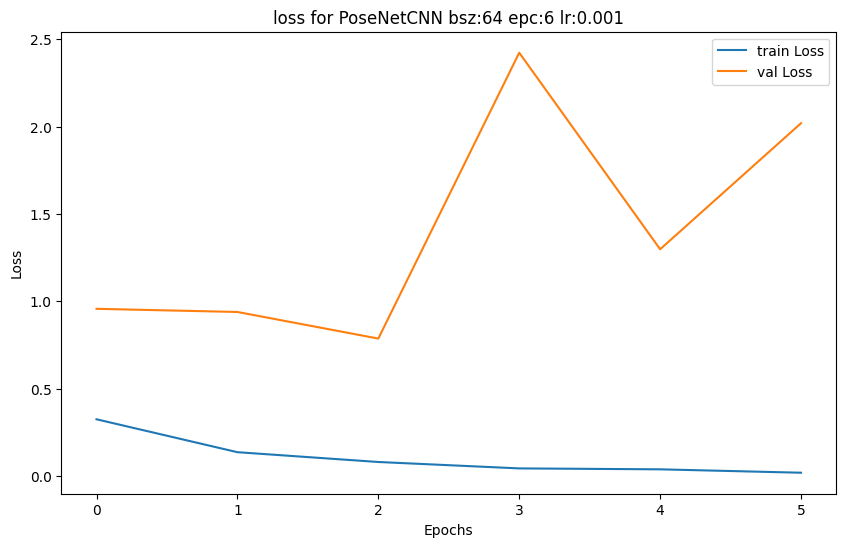

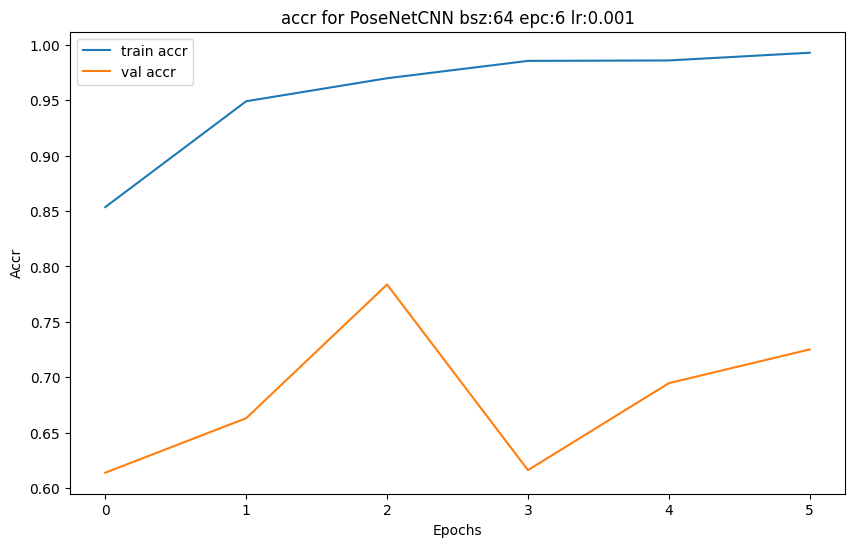

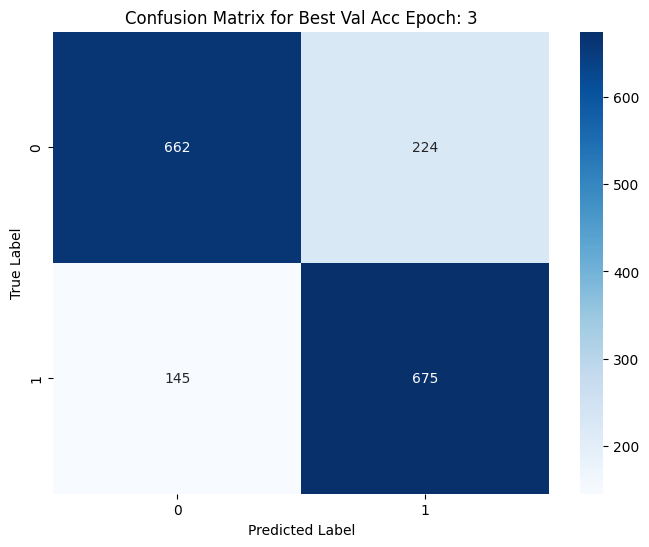

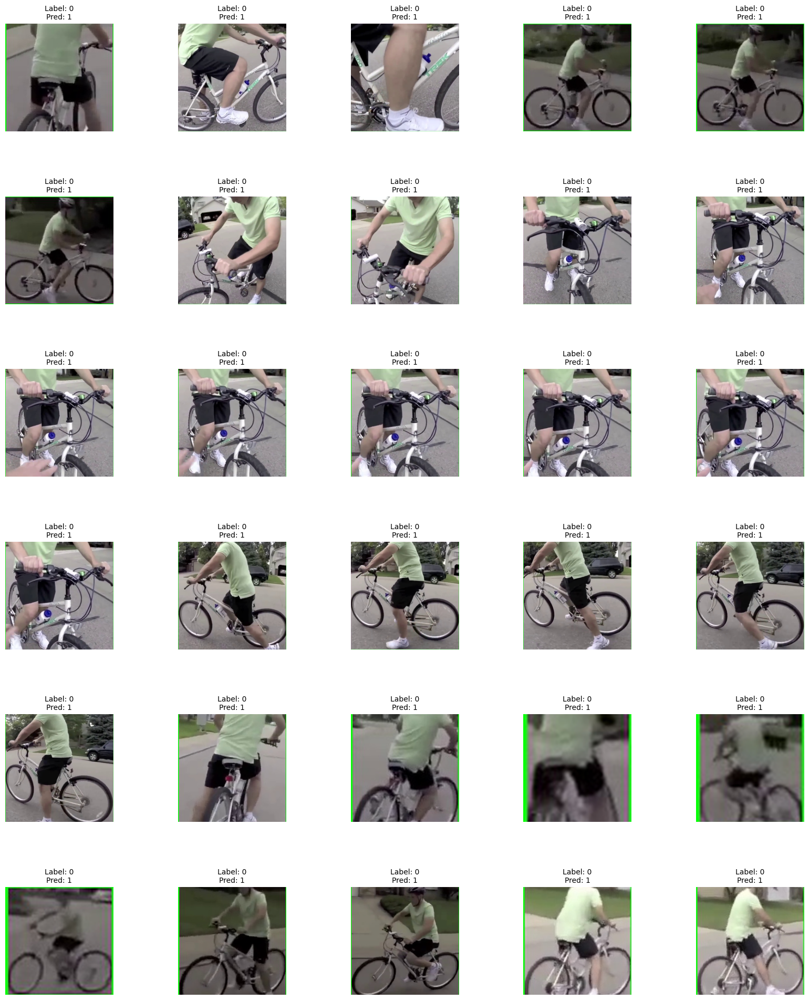

In [17]:
yoloPoseModel = YOLO('F:/UT_MIE/MIE1517/Project/yolov8n-pose.pt') 

PoseNetCNN_model = PoseNetCNN()
# # data parallel
# # model = nn.DataParallel(model, device_ids=[0, 1])
PoseNetCNN_model.to(torch.device("cuda:0"))

train_PoseNetCNN(train_dataset=train_dataset,
            val_dataset=val_dataset,
            model=PoseNetCNN_model,
            num_epochs=10,
            bsz=64,
            lr=0.001,
            patience=3,
            PoseNetModel=yoloPoseModel,
            use_gpu=True,
            plot_=True,
            model_dir='models')

## PoseNet + Resnet18

In [18]:
class PoseNetResnet(nn.Module):
    def __init__(self, num_keypoints=17, num_classes=1, lrelu_tr=0.1, pretrained=True):
        super(PoseNetResnet, self).__init__()
        self.name = "PoseNetResnet"

        # Load a pretrained ResNet18 model
        self.resnet = models.resnet18(pretrained=pretrained)
        
        # Remove the fully connected layers (fc) of ResNet18
        self.resnet = nn.Sequential(*(list(self.resnet.children())[:-2]))
        
        # MLP for processing keypoints
        self.yoloMLP = nn.Sequential(
            nn.Linear(num_keypoints * 2, 128),  # 17 * 2 (x, y)
            nn.LeakyReLU(lrelu_tr),
            nn.Linear(128, 64),
            nn.LeakyReLU(lrelu_tr)
        )
        
        # Combined MLP
        # ResNet18 with default settings ends with 512 channels at 7x7 spatial dimensions, when the input is 224x224
        self.combinedMLP = nn.Sequential(
            nn.Linear(512 * 7 * 7 + 64, 1024),
            nn.ReLU(),
            nn.Linear(1024, 256),
            nn.ReLU(),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.Linear(128, num_classes)
        )

    def forward(self, x, keypoints):
        # Process images through the ResNet18 model
        x = self.resnet(x)
        x = torch.flatten(x, 1)

        # yoloMLP
        keypoints = keypoints.view(keypoints.size(0), -1)
        yoloMLP_out = self.yoloMLP(keypoints)

        # concat
        concat_features = torch.cat((x, yoloMLP_out), dim=1)

        # combined MLP
        output = self.combinedMLP(concat_features)

        return output

c:\Users\Ningxin Cynthia Li\anaconda3\envs\MIE\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Ningxin Cynthia Li\anaconda3\envs\MIE\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


curr device: cuda


Epoch 1/10: 100%|██████████| 117/117 [00:26<00:00,  4.34it/s]


Epoch 1: Train Loss: 0.2982, Acc: 0.8877, Precision: 0.8809, Recall: 0.8947, F1: 0.8878
         Val Loss: 1.4411, Acc: 0.7075, Precision: 0.6743, Recall: 0.7573, F1: 0.7134


Epoch 2/10: 100%|██████████| 117/117 [00:26<00:00,  4.36it/s]


Epoch 2: Train Loss: 0.0820, Acc: 0.9714, Precision: 0.9689, Recall: 0.9738, F1: 0.9713
         Val Loss: 0.4754, Acc: 0.8341, Precision: 0.8990, Recall: 0.7378, F1: 0.8104


Epoch 3/10: 100%|██████████| 117/117 [00:26<00:00,  4.34it/s]


Epoch 3: Train Loss: 0.0799, Acc: 0.9737, Precision: 0.9715, Recall: 0.9757, F1: 0.9736
         Val Loss: 1.5276, Acc: 0.6981, Precision: 0.6156, Recall: 0.9902, F1: 0.7592
no improvement in val loss for 1 epochs.


Epoch 4/10: 100%|██████████| 117/117 [00:26<00:00,  4.39it/s]


Epoch 4: Train Loss: 0.0490, Acc: 0.9840, Precision: 0.9822, Recall: 0.9857, F1: 0.9840
         Val Loss: 0.9366, Acc: 0.7309, Precision: 0.6552, Recall: 0.9293, F1: 0.7685
no improvement in val loss for 2 epochs.


Epoch 5/10: 100%|██████████| 117/117 [00:26<00:00,  4.36it/s]


Epoch 5: Train Loss: 0.0448, Acc: 0.9862, Precision: 0.9841, Recall: 0.9881, F1: 0.9861
         Val Loss: 0.5165, Acc: 0.8564, Precision: 0.7992, Recall: 0.9366, F1: 0.8624
no improvement in val loss for 3 epochs.
patient exceeded, early stop triggered at epoch 4

Best val corr observed at 5: 0.8563892145369285
Best val loss observed at 2: 0.4753907447749818
Best val F1 observed at 5: 0.862436833239753


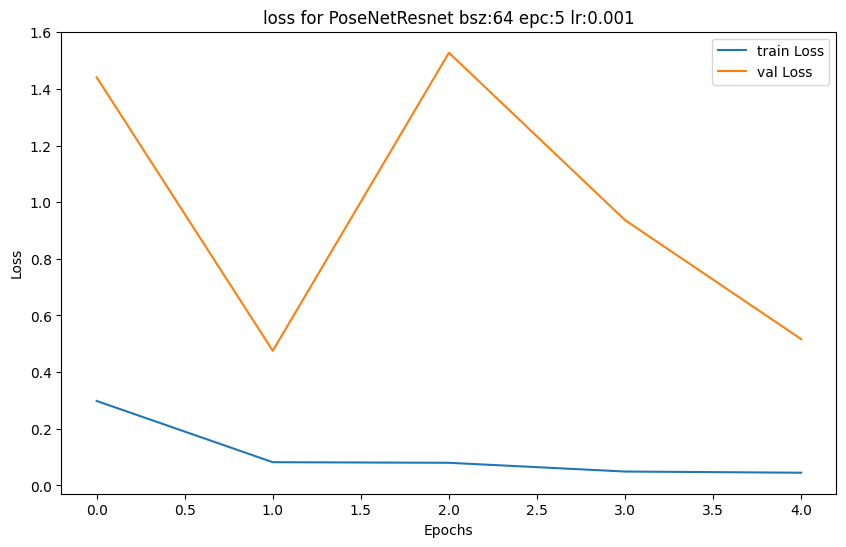

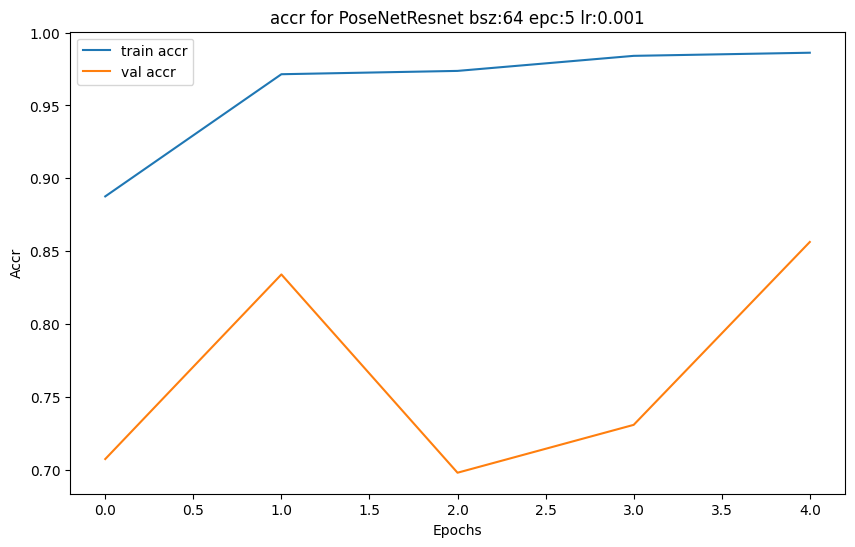

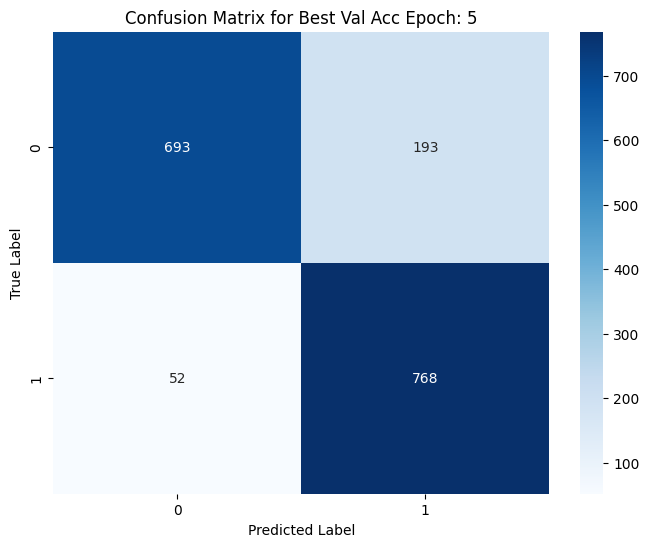

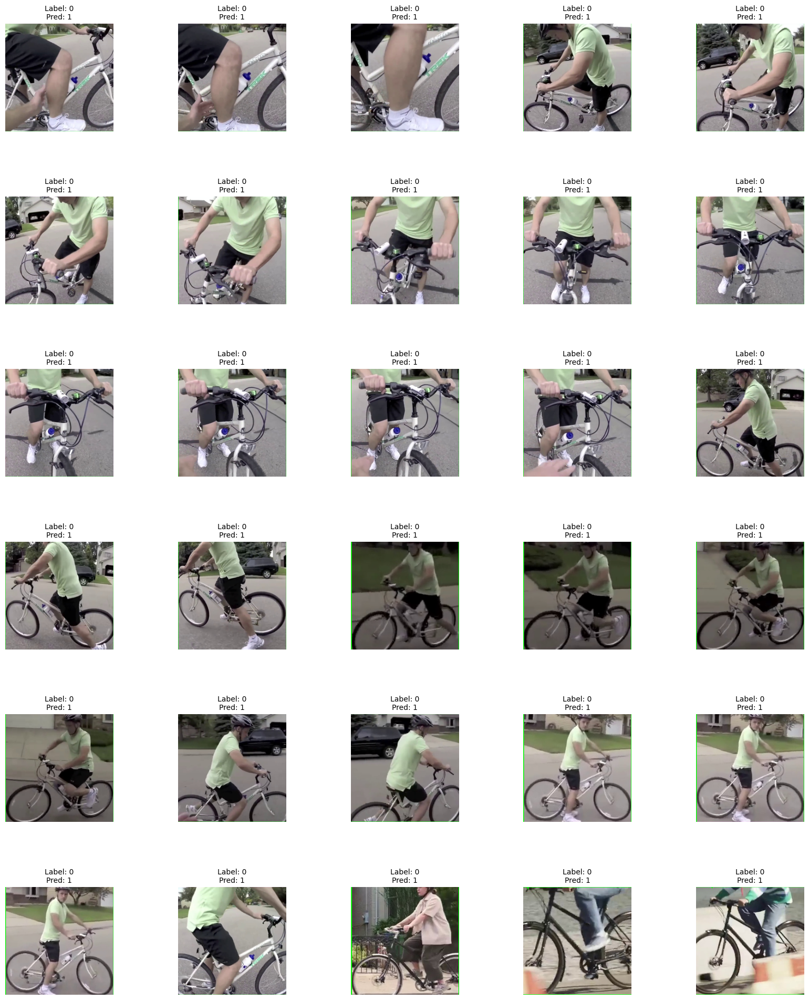

In [19]:
yoloPoseModel = YOLO('F:/UT_MIE/MIE1517/Project/yolov8n-pose.pt') 

PoseNetCNN_model = PoseNetResnet()
# # data parallel
# # model = nn.DataParallel(model, device_ids=[0, 1])
PoseNetCNN_model.to(torch.device("cuda:0"))

train_PoseNetCNN(train_dataset=train_dataset,
            val_dataset=val_dataset,
            model=PoseNetCNN_model,
            num_epochs=10,
            bsz=64,
            lr=0.001,
            patience=3,
            PoseNetModel=yoloPoseModel,
            use_gpu=True,
            plot_=True,
            model_dir='models')

In [20]:
# yoloPoseModel = YOLO('F:/UT_MIE/MIE1517/Project/yolov8l-pose.pt') 

# PoseNetCNN_model = PoseNetResnet()
# # # data parallel
# # # model = nn.DataParallel(model, device_ids=[0, 1])
# PoseNetCNN_model.to(torch.device("cuda:0"))

# train_PoseNetCNN(train_dataset=train_dataset,
#             val_dataset=val_dataset,
#             model=PoseNetCNN_model,
#             num_epochs=15,
#             bsz=64,
#             lr=0.001,
#             patience=3,
#             PoseNetModel=yoloPoseModel,
#             use_gpu=True,
#             plot_=True)

## SqueezeNet + Pose

In [21]:
class PoseNetSqueeze(nn.Module):
    def __init__(self, num_keypoints=17, num_classes=1, lrelu_tr=0.1, pretrained=True):
        super(PoseNetSqueeze, self).__init__()
        self.name = "PoseNetSqueeze"

        # Load a pretrained SqueezeNet model
        self.squeezenet = models.squeezenet1_0(pretrained=pretrained)

        # Remove the classifier of SqueezeNet
        # SqueezeNet uses a classifier that starts with a 'dropout' layer
        self.squeezenet.features = nn.Sequential(*list(self.squeezenet.children())[0])
        
        # SqueezeNet's final convolution layer outputs 512 channels with a 13x13 spatial dimension when the input is 224x224
        # We need to adapt the combined MLP to this new structure
        final_conv = nn.Conv2d(512, num_classes, kernel_size=1)
        self.squeezenet.classifier = nn.Sequential(
            nn.Dropout(p=0.5),
            final_conv,
            nn.ReLU(inplace=True),
            nn.AdaptiveAvgPool2d((1, 1))
        )
        
        # MLP for processing keypoints
        self.yoloMLP = nn.Sequential(
            nn.Linear(num_keypoints * 2, 128),  # 17 * 2 (x, y)
            nn.LeakyReLU(lrelu_tr),
            nn.Linear(128, 64),
            nn.LeakyReLU(lrelu_tr)
        )
        
        # Combined MLP
        # Adjust the input features of the combinedMLP to match SqueezeNet's output
        self.combinedMLP = nn.Sequential(
            nn.Linear(num_classes + 64, 1024),
            nn.ReLU(),
            nn.Linear(1024, 256),
            nn.ReLU(),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.Linear(128, num_classes)
        )

    def forward(self, x, keypoints):
        # Process images through the SqueezeNet model
        x = self.squeezenet.features(x)
        x = self.squeezenet.classifier(x)
        x = torch.flatten(x, 1)

        # yoloMLP
        keypoints = keypoints.view(keypoints.size(0), -1)
        yoloMLP_out = self.yoloMLP(keypoints)

        # Concatenate SqueezeNet features and keypoints MLP output
        concat_features = torch.cat((x, yoloMLP_out), dim=1)

        # Combined MLP
        output = self.combinedMLP(concat_features)

        return output

c:\Users\Ningxin Cynthia Li\anaconda3\envs\MIE\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Ningxin Cynthia Li\anaconda3\envs\MIE\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=SqueezeNet1_0_Weights.IMAGENET1K_V1`. You can also use `weights=SqueezeNet1_0_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


curr device: cuda


Epoch 1/10:   0%|          | 0/117 [00:00<?, ?it/s]

Epoch 1/10: 100%|██████████| 117/117 [00:25<00:00,  4.57it/s]


Epoch 1: Train Loss: 0.5102, Acc: 0.7689, Precision: 0.8126, Recall: 0.6950, F1: 0.7492
         Val Loss: 0.7540, Acc: 0.6249, Precision: 0.5879, Recall: 0.7341, F1: 0.6529


Epoch 2/10: 100%|██████████| 117/117 [00:25<00:00,  4.62it/s]


Epoch 2: Train Loss: 0.3905, Acc: 0.8265, Precision: 0.9001, Recall: 0.7320, F1: 0.8074
         Val Loss: 0.6412, Acc: 0.6776, Precision: 0.6380, Recall: 0.7610, F1: 0.6941


Epoch 3/10: 100%|██████████| 117/117 [00:25<00:00,  4.61it/s]


Epoch 3: Train Loss: 0.3646, Acc: 0.8372, Precision: 0.9120, Recall: 0.7441, F1: 0.8196
         Val Loss: 0.7288, Acc: 0.7122, Precision: 0.6863, Recall: 0.7390, F1: 0.7117
no improvement in val loss for 1 epochs.


Epoch 4/10: 100%|██████████| 117/117 [00:25<00:00,  4.59it/s]


Epoch 4: Train Loss: 0.3571, Acc: 0.8382, Precision: 0.9100, Recall: 0.7482, F1: 0.8212
         Val Loss: 0.9783, Acc: 0.6336, Precision: 0.5959, Recall: 0.7390, F1: 0.6598
no improvement in val loss for 2 epochs.


Epoch 5/10: 100%|██████████| 117/117 [00:25<00:00,  4.59it/s]


Epoch 5: Train Loss: 0.3505, Acc: 0.8429, Precision: 0.9206, Recall: 0.7482, F1: 0.8255
         Val Loss: 0.9460, Acc: 0.6079, Precision: 0.5717, Recall: 0.7341, F1: 0.6428
no improvement in val loss for 3 epochs.
patient exceeded, early stop triggered at epoch 4

Best val corr observed at 3: 0.7121922626025792
Best val loss observed at 2: 0.6411704967419306
Best val F1 observed at 3: 0.7116852613035819


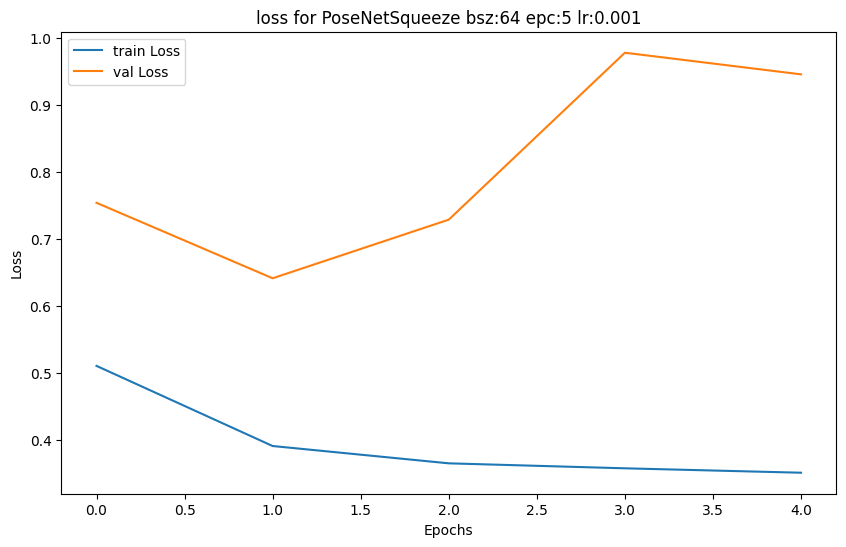

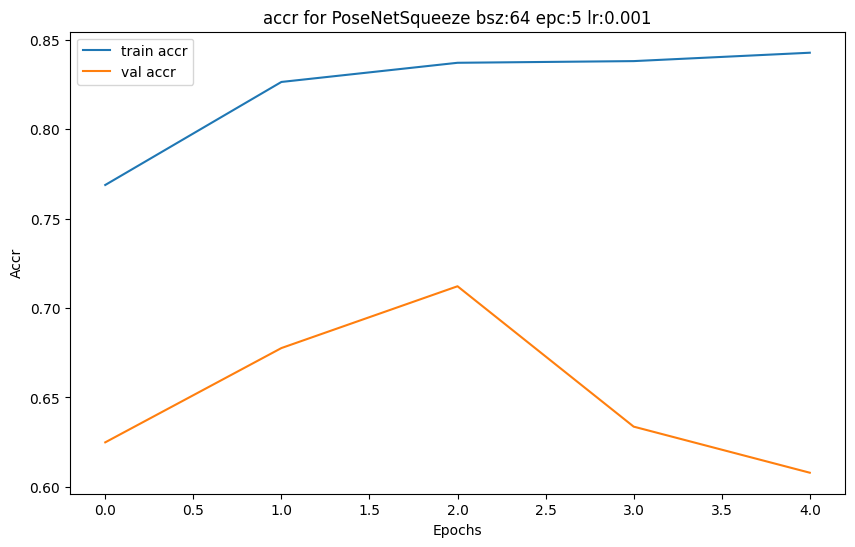

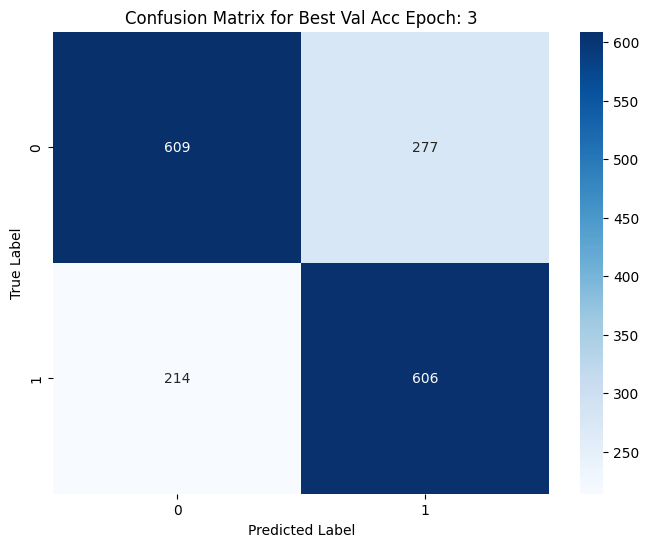

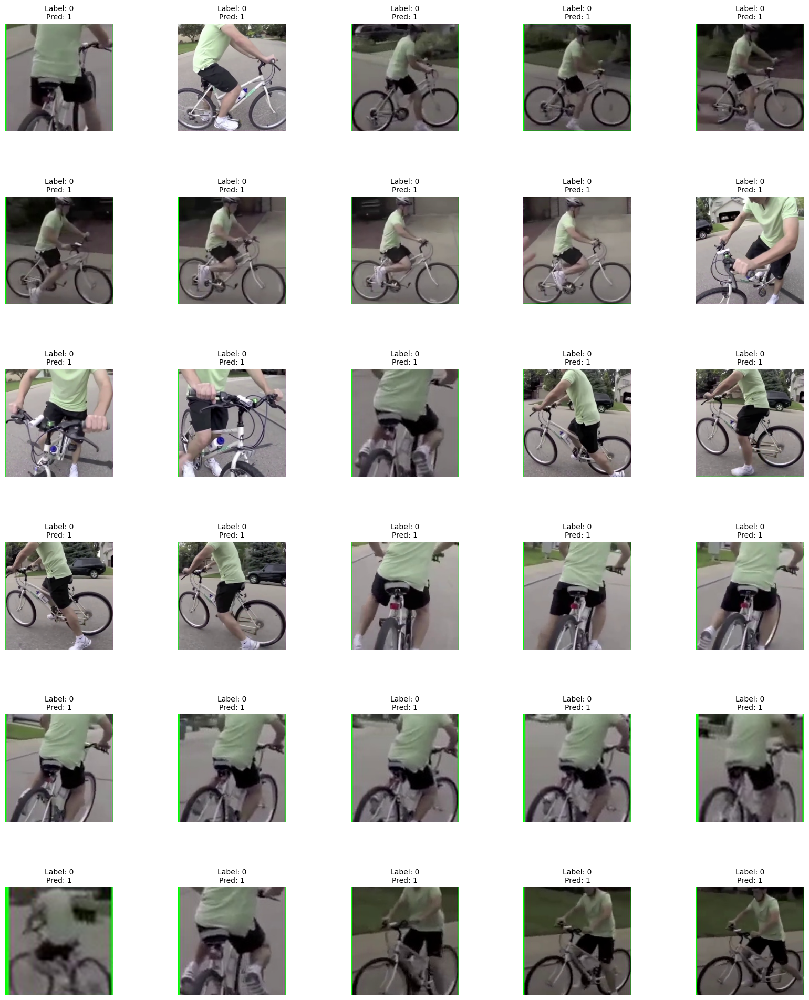

In [22]:
yoloPoseModel = YOLO('F:/UT_MIE/MIE1517/Project/yolov8n-pose.pt') 

PoseNetCNN_model = PoseNetSqueeze()
# # data parallel
# # model = nn.DataParallel(model, device_ids=[0, 1])
PoseNetCNN_model.to(torch.device("cuda:0"))

train_PoseNetCNN(train_dataset=train_dataset,
            val_dataset=val_dataset,
            model=PoseNetCNN_model,
            num_epochs=10,
            bsz=64,
            lr=0.001,
            patience=3,
            PoseNetModel=yoloPoseModel,
            use_gpu=True,
            plot_=True,
            model_dir='models')

# Hyperparameter Tuning

In [33]:
class PoseNetCNN1(nn.Module):
    def __init__(self, num_keypoints=17, num_classes=1, lrelu_tr=0.1, dropout_cnn=0.2, dropout_mlp=0.2):
        super(PoseNetCNN1, self).__init__()
        self.name = "PoseNetCNN_1"
        
        # Convolutional layers with dropout after activation and pooling
        self.cnn = nn.Sequential(
            nn.Conv2d(3, 32, 3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, 2),
            nn.Dropout(dropout_cnn),  # Adding dropout
            nn.Conv2d(32, 64, 3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, 2),
            nn.Dropout(dropout_cnn),  # Adding dropout
            nn.Conv2d(64, 128, 3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, 2),
            nn.Dropout(dropout_cnn)   # Adding dropout
        )
        
        # MLP for YOLO keypoints with dropout after LeakyReLU
        self.yoloMLP = nn.Sequential(
            nn.Linear(num_keypoints * 2, 128),
            nn.LeakyReLU(lrelu_tr),
            nn.Dropout(dropout_mlp),  # Adding dropout
            nn.Linear(128, 64),
            nn.LeakyReLU(lrelu_tr),
            nn.Dropout(dropout_mlp)   # Adding dropout
        )
        
        # Combined MLP with dropout after activation
        self.combinedMLP = nn.Sequential(
            nn.Linear(128 * 28 * 28 + 64, 1024),
            nn.ReLU(),
            nn.Dropout(dropout_mlp),  # Adding dropout
            nn.Linear(1024, 256),
            nn.ReLU(),
            nn.Dropout(dropout_mlp),  # Adding dropout
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.Dropout(dropout_mlp),  # Adding dropout
            nn.Linear(128, num_classes)
        )

    def forward(self, x, keypoints):
        # CNN
        x = self.cnn(x)
        x = torch.flatten(x, 1)  

        # YOLO MLP
        keypoints = keypoints.view(keypoints.size(0), -1)
        yoloMLP_out = self.yoloMLP(keypoints)
        
        # Concatenation
        concat_features = torch.cat((x, yoloMLP_out), dim=1)
        
        # Combined MLP
        output = self.combinedMLP(concat_features)
        
        return output

curr device: cuda


Epoch 1/10: 100%|██████████| 117/117 [00:25<00:00,  4.55it/s]


Epoch 1: Train Loss: 0.5245, Acc: 0.7411, Precision: 0.7157, Recall: 0.7943, F1: 0.7530
         Val Loss: 0.7470, Acc: 0.6090, Precision: 0.5712, Recall: 0.7488, F1: 0.6480


Epoch 2/10: 100%|██████████| 117/117 [00:25<00:00,  4.53it/s]


Epoch 2: Train Loss: 0.2302, Acc: 0.9103, Precision: 0.9061, Recall: 0.9142, F1: 0.9101
         Val Loss: 0.7334, Acc: 0.6688, Precision: 0.6287, Recall: 0.7598, F1: 0.6880


Epoch 3/10: 100%|██████████| 117/117 [00:25<00:00,  4.53it/s]


Epoch 3: Train Loss: 0.1486, Acc: 0.9437, Precision: 0.9417, Recall: 0.9452, F1: 0.9434
         Val Loss: 0.6893, Acc: 0.6970, Precision: 0.6420, Recall: 0.8354, F1: 0.7260


Epoch 4/10: 100%|██████████| 117/117 [00:26<00:00,  4.49it/s]


Epoch 4: Train Loss: 0.1056, Acc: 0.9591, Precision: 0.9577, Recall: 0.9601, F1: 0.9589
         Val Loss: 1.0719, Acc: 0.7233, Precision: 0.6436, Recall: 0.9512, F1: 0.7677
no improvement in val loss for 1 epochs.


Epoch 5/10: 100%|██████████| 117/117 [00:25<00:00,  4.58it/s]


Epoch 5: Train Loss: 0.0726, Acc: 0.9744, Precision: 0.9741, Recall: 0.9744, F1: 0.9742
         Val Loss: 1.4066, Acc: 0.6893, Precision: 0.6114, Recall: 0.9707, F1: 0.7502
no improvement in val loss for 2 epochs.


Epoch 6/10: 100%|██████████| 117/117 [00:25<00:00,  4.59it/s]


Epoch 6: Train Loss: 0.0626, Acc: 0.9804, Precision: 0.9803, Recall: 0.9803, F1: 0.9803
         Val Loss: 0.6768, Acc: 0.7069, Precision: 0.6524, Recall: 0.8354, F1: 0.7326


Epoch 7/10: 100%|██████████| 117/117 [00:25<00:00,  4.59it/s]


Epoch 7: Train Loss: 0.0412, Acc: 0.9855, Precision: 0.9839, Recall: 0.9870, F1: 0.9854
         Val Loss: 1.3687, Acc: 0.7339, Precision: 0.6548, Recall: 0.9439, F1: 0.7732
no improvement in val loss for 1 epochs.


Epoch 8/10: 100%|██████████| 117/117 [00:25<00:00,  4.54it/s]


Epoch 8: Train Loss: 0.0310, Acc: 0.9893, Precision: 0.9903, Recall: 0.9881, F1: 0.9892
         Val Loss: 1.5089, Acc: 0.7907, Precision: 0.7061, Recall: 0.9671, F1: 0.8163
no improvement in val loss for 2 epochs.


Epoch 9/10: 100%|██████████| 117/117 [00:25<00:00,  4.56it/s]


Epoch 9: Train Loss: 0.0283, Acc: 0.9906, Precision: 0.9892, Recall: 0.9919, F1: 0.9906
         Val Loss: 1.5368, Acc: 0.7831, Precision: 0.7009, Recall: 0.9573, F1: 0.8093
no improvement in val loss for 3 epochs.
patient exceeded, early stop triggered at epoch 8

Best val corr observed at 8: 0.7907385697538101
Best val loss observed at 6: 0.6767545350723796
Best val F1 observed at 8: 0.8162635100360268


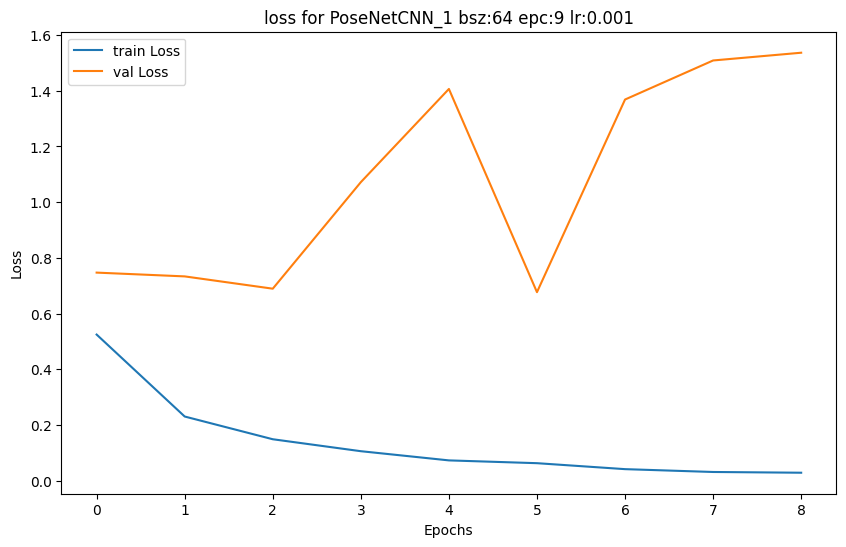

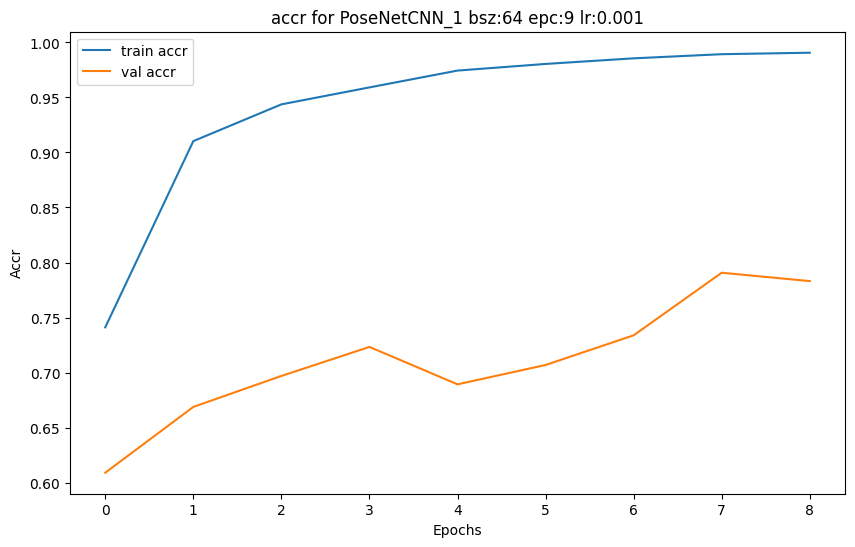

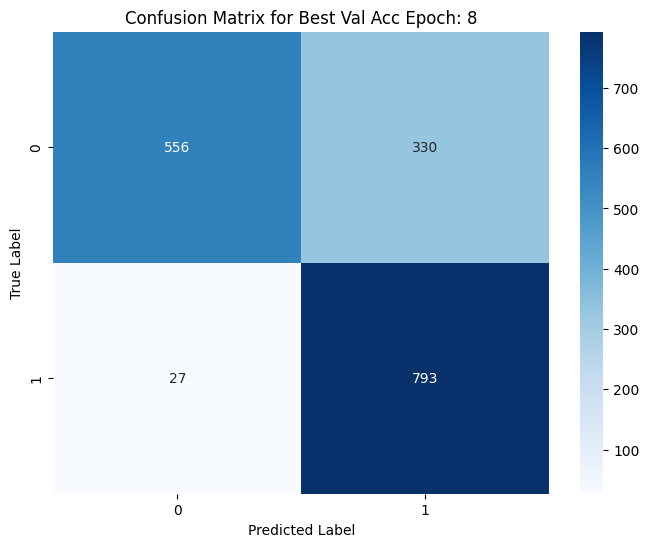

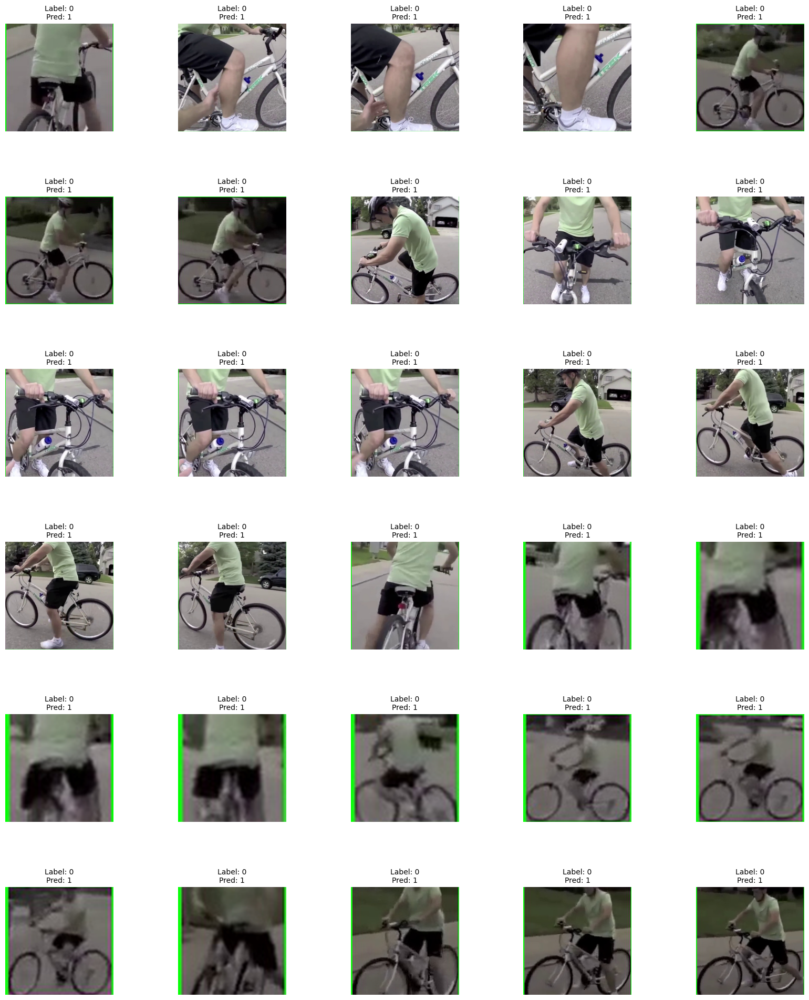

In [24]:
yoloPoseModel = YOLO('F:/UT_MIE/MIE1517/Project/yolov8n-pose.pt') 

PoseNetCNN_model = PoseNetCNN(lrelu_tr=0.1, dropout_cnn=0.2, dropout_mlp=0.2)
# # data parallel
# # model = nn.DataParallel(model, device_ids=[0, 1])
PoseNetCNN_model.to(torch.device("cuda:0"))

train_PoseNetCNN(train_dataset=train_dataset,
            val_dataset=val_dataset,
            model=PoseNetCNN_model,
            num_epochs=10,
            bsz=64,
            lr=0.001,
            patience=3,
            PoseNetModel=yoloPoseModel,
            use_gpu=True,
            plot_=True,
            model_dir='models')

curr device: cuda


Epoch 1/10: 100%|██████████| 117/117 [00:26<00:00,  4.39it/s]


Epoch 1: Train Loss: 0.4773, Acc: 0.7737, Precision: 0.7490, Recall: 0.8189, F1: 0.7824
         Val Loss: 0.8172, Acc: 0.5692, Precision: 0.5365, Recall: 0.7610, F1: 0.6293


Epoch 2/10: 100%|██████████| 117/117 [00:25<00:00,  4.51it/s]


Epoch 2: Train Loss: 0.2271, Acc: 0.9067, Precision: 0.9015, Recall: 0.9117, F1: 0.9066
         Val Loss: 1.0239, Acc: 0.5791, Precision: 0.5378, Recall: 0.8841, F1: 0.6688
no improvement in val loss for 1 epochs.


Epoch 3/10: 100%|██████████| 117/117 [00:25<00:00,  4.56it/s]


Epoch 3: Train Loss: 0.1636, Acc: 0.9359, Precision: 0.9346, Recall: 0.9366, F1: 0.9356
         Val Loss: 0.6934, Acc: 0.6958, Precision: 0.6243, Recall: 0.9220, F1: 0.7445


Epoch 4/10: 100%|██████████| 117/117 [00:25<00:00,  4.56it/s]


Epoch 4: Train Loss: 0.1301, Acc: 0.9524, Precision: 0.9460, Recall: 0.9590, F1: 0.9524
         Val Loss: 1.4917, Acc: 0.5774, Precision: 0.5325, Recall: 0.9902, F1: 0.6925
no improvement in val loss for 1 epochs.


Epoch 5/10: 100%|██████████| 117/117 [00:25<00:00,  4.54it/s]


Epoch 5: Train Loss: 0.1005, Acc: 0.9637, Precision: 0.9603, Recall: 0.9668, F1: 0.9636
         Val Loss: 0.8668, Acc: 0.6342, Precision: 0.5702, Recall: 0.9707, F1: 0.7184
no improvement in val loss for 2 epochs.


Epoch 6/10: 100%|██████████| 117/117 [00:25<00:00,  4.54it/s]


Epoch 6: Train Loss: 0.0682, Acc: 0.9763, Precision: 0.9762, Recall: 0.9760, F1: 0.9761
         Val Loss: 1.3054, Acc: 0.6876, Precision: 0.6145, Recall: 0.9390, F1: 0.7429
no improvement in val loss for 3 epochs.
patient exceeded, early stop triggered at epoch 5

Best val corr observed at 3: 0.6957796014067995
Best val loss observed at 3: 0.693380561415796
Best val F1 observed at 3: 0.7444608567208272


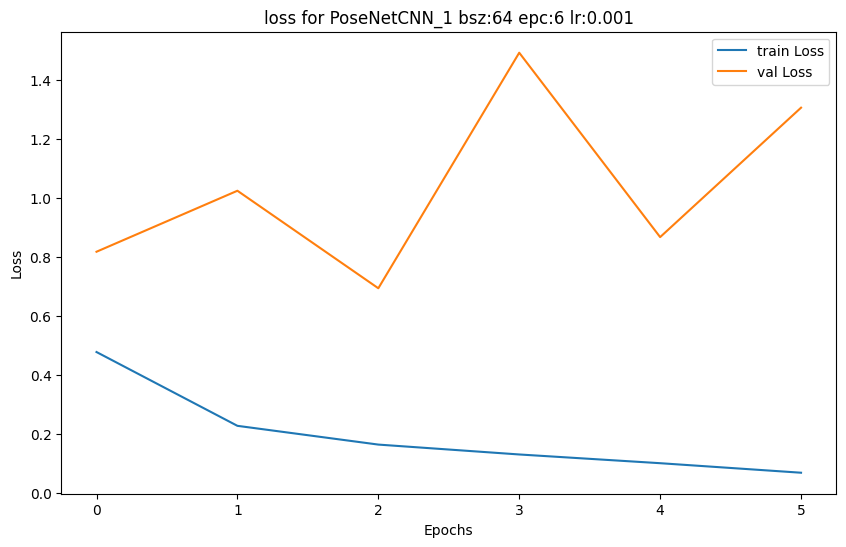

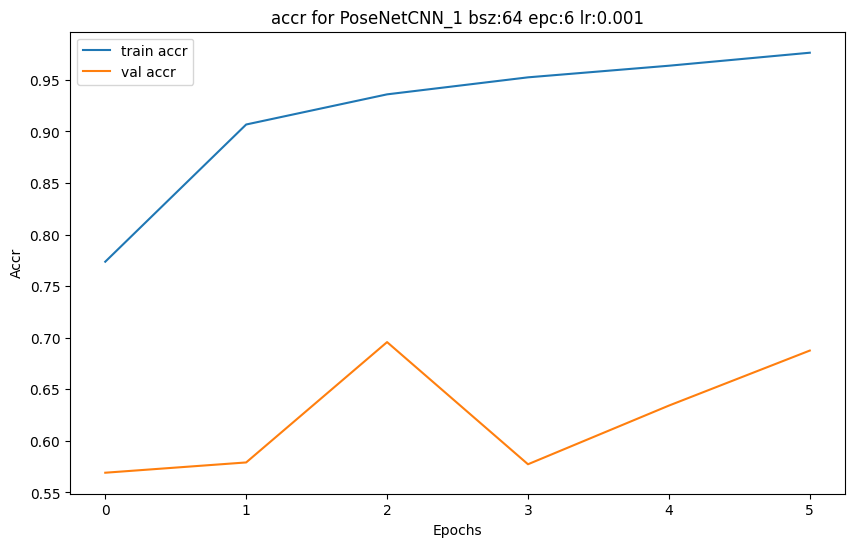

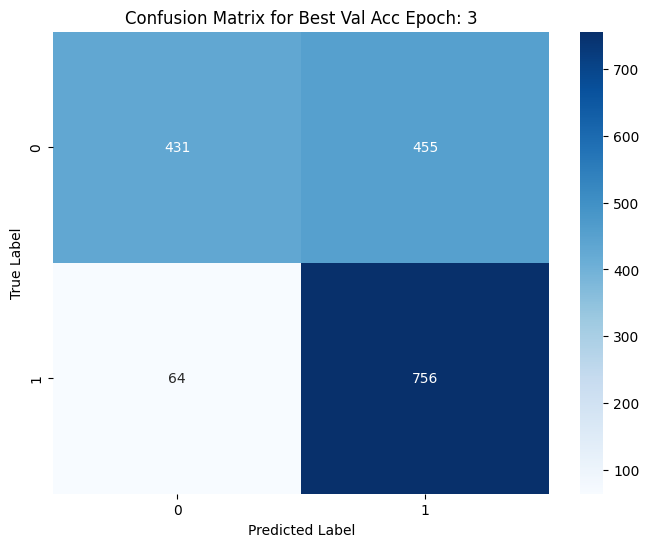

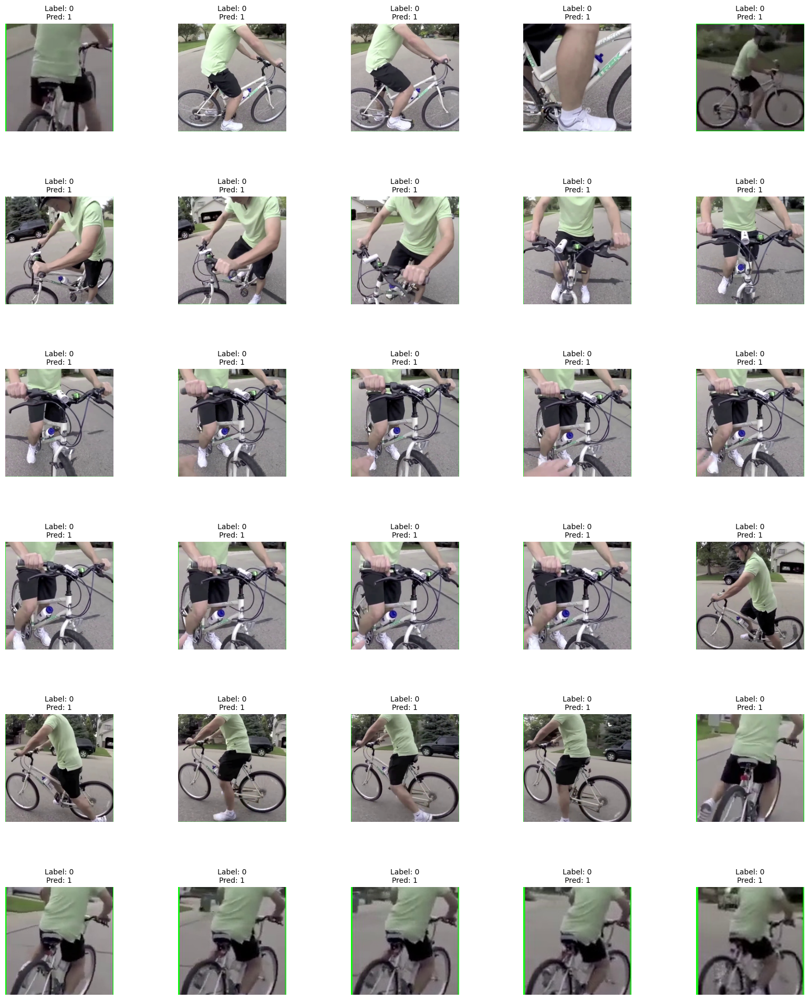

In [36]:
yoloPoseModel = YOLO('F:/UT_MIE/MIE1517/Project/yolov8n-pose.pt') 

PoseNetCNN_model = PoseNetCNN1(lrelu_tr=0.1, dropout_cnn=0.3, dropout_mlp=0.3)
# # data parallel
# # model = nn.DataParallel(model, device_ids=[0, 1])
PoseNetCNN_model.to(torch.device("cuda:0"))

train_PoseNetCNN(train_dataset=train_dataset,
            val_dataset=val_dataset,
            model=PoseNetCNN_model,
            num_epochs=10,
            bsz=64,
            lr=0.001,
            patience=3,
            PoseNetModel=yoloPoseModel,
            use_gpu=True,
            plot_=True,
            model_dir='models')

curr device: cuda


Epoch 1/10: 100%|██████████| 117/117 [00:26<00:00,  4.47it/s]


Epoch 1: Train Loss: 0.3961, Acc: 0.8073, Precision: 0.7814, Recall: 0.8499, F1: 0.8142
         Val Loss: 0.7169, Acc: 0.6788, Precision: 0.6341, Recall: 0.7841, F1: 0.7012


Epoch 2/10: 100%|██████████| 117/117 [00:25<00:00,  4.56it/s]


Epoch 2: Train Loss: 0.1815, Acc: 0.9296, Precision: 0.9293, Recall: 0.9290, F1: 0.9291
         Val Loss: 0.7689, Acc: 0.6999, Precision: 0.6360, Recall: 0.8780, F1: 0.7377
no improvement in val loss for 1 epochs.


Epoch 3/10: 100%|██████████| 117/117 [00:25<00:00,  4.56it/s]


Epoch 3: Train Loss: 0.0993, Acc: 0.9639, Precision: 0.9656, Recall: 0.9617, F1: 0.9636
         Val Loss: 0.4863, Acc: 0.8259, Precision: 0.8289, Recall: 0.8037, F1: 0.8161


Epoch 4/10: 100%|██████████| 117/117 [00:25<00:00,  4.56it/s]


Epoch 4: Train Loss: 0.0800, Acc: 0.9708, Precision: 0.9683, Recall: 0.9730, F1: 0.9707
         Val Loss: 1.2781, Acc: 0.7263, Precision: 0.6422, Recall: 0.9720, F1: 0.7734
no improvement in val loss for 1 epochs.


Epoch 5/10: 100%|██████████| 117/117 [00:25<00:00,  4.56it/s]


Epoch 5: Train Loss: 0.0470, Acc: 0.9849, Precision: 0.9857, Recall: 0.9838, F1: 0.9847
         Val Loss: 1.1870, Acc: 0.7309, Precision: 0.6523, Recall: 0.9427, F1: 0.7711
no improvement in val loss for 2 epochs.


Epoch 6/10: 100%|██████████| 117/117 [00:25<00:00,  4.55it/s]


Epoch 6: Train Loss: 0.0332, Acc: 0.9877, Precision: 0.9871, Recall: 0.9881, F1: 0.9876
         Val Loss: 1.1412, Acc: 0.8236, Precision: 0.7830, Recall: 0.8756, F1: 0.8267
no improvement in val loss for 3 epochs.
patient exceeded, early stop triggered at epoch 5

Best val corr observed at 3: 0.8259085580304807
Best val loss observed at 3: 0.48632047794483324
Best val F1 observed at 6: 0.82671272308578


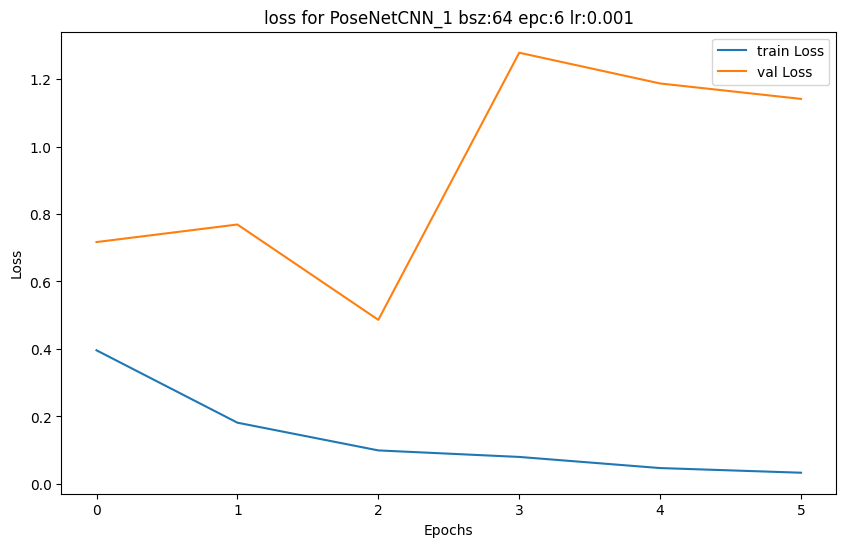

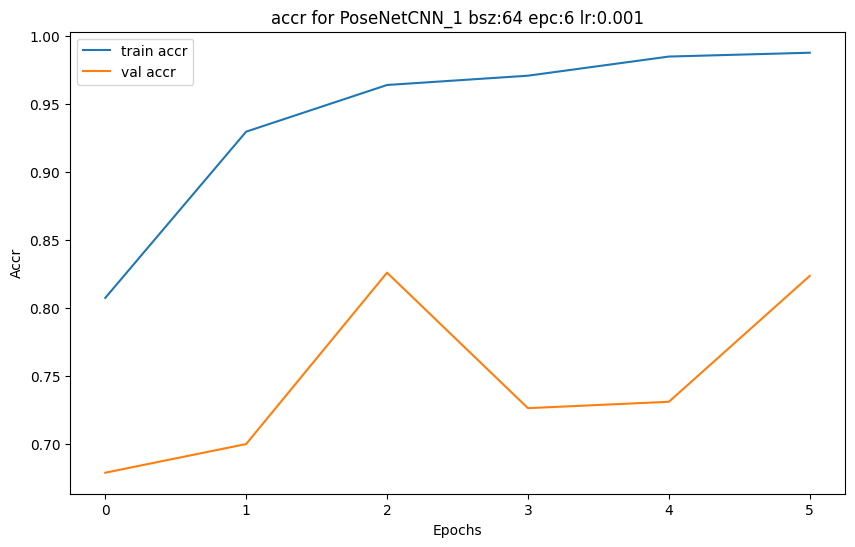

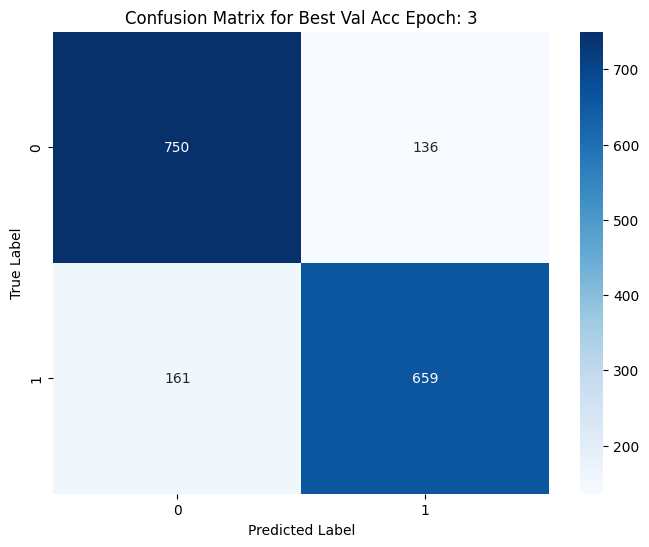

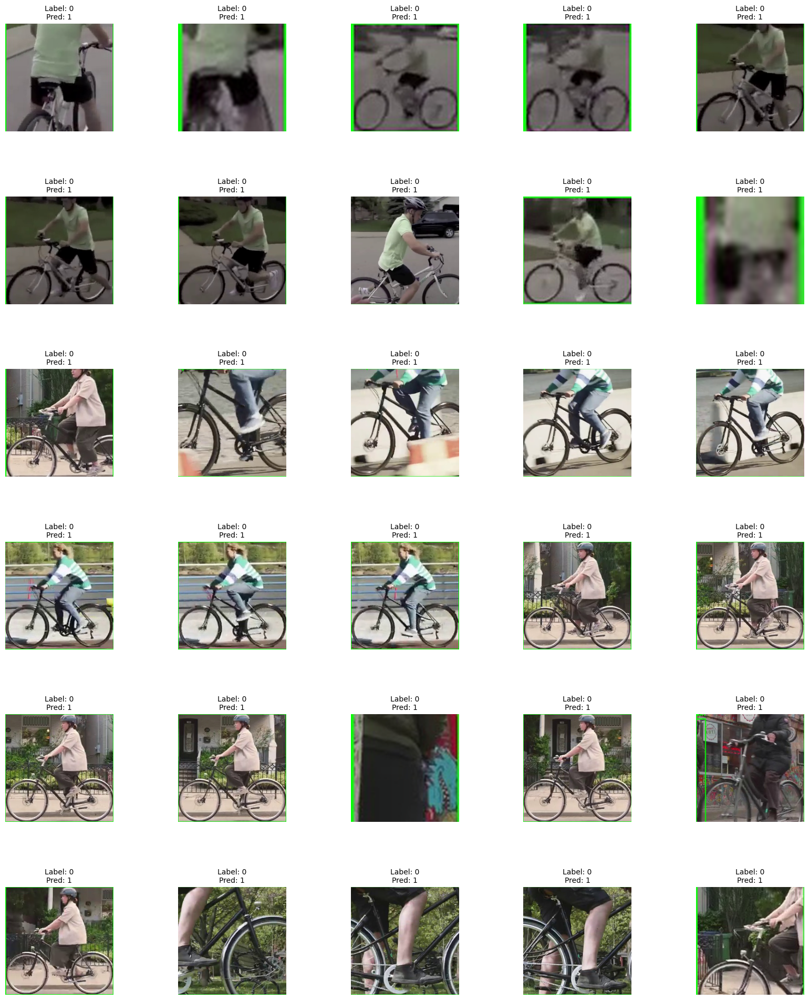

In [38]:
yoloPoseModel = YOLO('F:/UT_MIE/MIE1517/Project/yolov8n-pose.pt') 

PoseNetCNN_model = PoseNetCNN1(lrelu_tr=0.1, dropout_cnn=0.1, dropout_mlp=0.2)
# # data parallel
# # model = nn.DataParallel(model, device_ids=[0, 1])
PoseNetCNN_model.to(torch.device("cuda:0"))

train_PoseNetCNN(train_dataset=train_dataset,
            val_dataset=val_dataset,
            model=PoseNetCNN_model,
            num_epochs=10,
            bsz=64,
            lr=0.001,
            patience=3,
            PoseNetModel=yoloPoseModel,
            use_gpu=True,
            plot_=True,
            model_dir='models')

curr device: cuda


Epoch 1/10: 100%|██████████| 59/59 [00:24<00:00,  2.36it/s]


Epoch 1: Train Loss: 0.4280, Acc: 0.7871, Precision: 0.7626, Recall: 0.8297, F1: 0.7947
         Val Loss: 0.7080, Acc: 0.5586, Precision: 0.5379, Recall: 0.5805, F1: 0.5584


Epoch 2/10: 100%|██████████| 59/59 [00:24<00:00,  2.37it/s]


Epoch 2: Train Loss: 0.2633, Acc: 0.8898, Precision: 0.8833, Recall: 0.8966, F1: 0.8899
         Val Loss: 0.7421, Acc: 0.5821, Precision: 0.5605, Recall: 0.6049, F1: 0.5818
no improvement in val loss for 1 epochs.


Epoch 3/10: 100%|██████████| 59/59 [00:24<00:00,  2.39it/s]


Epoch 3: Train Loss: 0.2169, Acc: 0.9143, Precision: 0.9095, Recall: 0.9190, F1: 0.9142
         Val Loss: 0.7765, Acc: 0.6553, Precision: 0.6986, Recall: 0.4976, F1: 0.5812
no improvement in val loss for 2 epochs.


Epoch 4/10: 100%|██████████| 59/59 [00:24<00:00,  2.40it/s]


Epoch 4: Train Loss: 0.1683, Acc: 0.9334, Precision: 0.9321, Recall: 0.9339, F1: 0.9330
         Val Loss: 0.7018, Acc: 0.6717, Precision: 0.6448, Recall: 0.7061, F1: 0.6740


Epoch 5/10: 100%|██████████| 59/59 [00:24<00:00,  2.39it/s]


Epoch 5: Train Loss: 0.1607, Acc: 0.9382, Precision: 0.9363, Recall: 0.9395, F1: 0.9379
         Val Loss: 0.7374, Acc: 0.6823, Precision: 0.7100, Recall: 0.5732, F1: 0.6343
no improvement in val loss for 1 epochs.


Epoch 6/10: 100%|██████████| 59/59 [00:24<00:00,  2.36it/s]


Epoch 6: Train Loss: 0.1270, Acc: 0.9535, Precision: 0.9504, Recall: 0.9563, F1: 0.9533
         Val Loss: 0.8058, Acc: 0.6882, Precision: 0.7667, Recall: 0.5049, F1: 0.6088
no improvement in val loss for 2 epochs.


Epoch 7/10: 100%|██████████| 59/59 [00:30<00:00,  1.91it/s]


Epoch 7: Train Loss: 0.1095, Acc: 0.9621, Precision: 0.9597, Recall: 0.9641, F1: 0.9619
         Val Loss: 0.7092, Acc: 0.7333, Precision: 0.7874, Recall: 0.6098, F1: 0.6873
no improvement in val loss for 3 epochs.
patient exceeded, early stop triggered at epoch 6

Best val corr observed at 7: 0.7332942555685815
Best val loss observed at 4: 0.7018038162163326
Best val F1 observed at 7: 0.6872852233676976


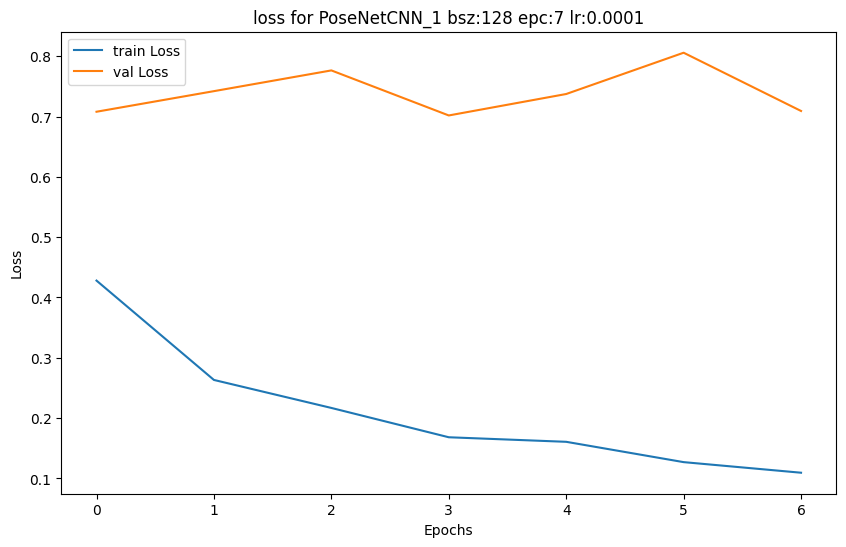

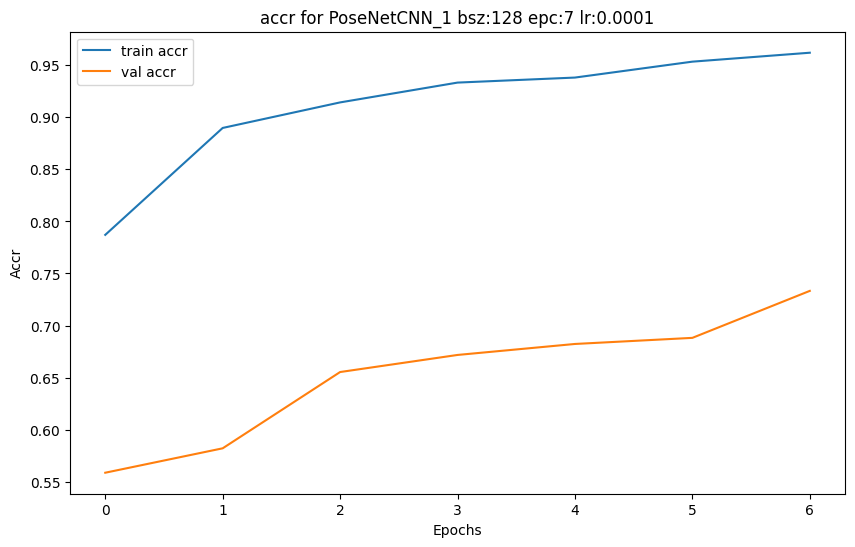

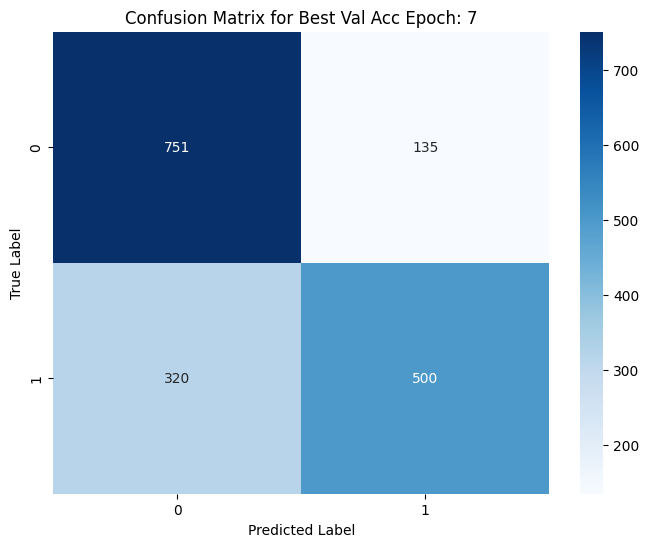

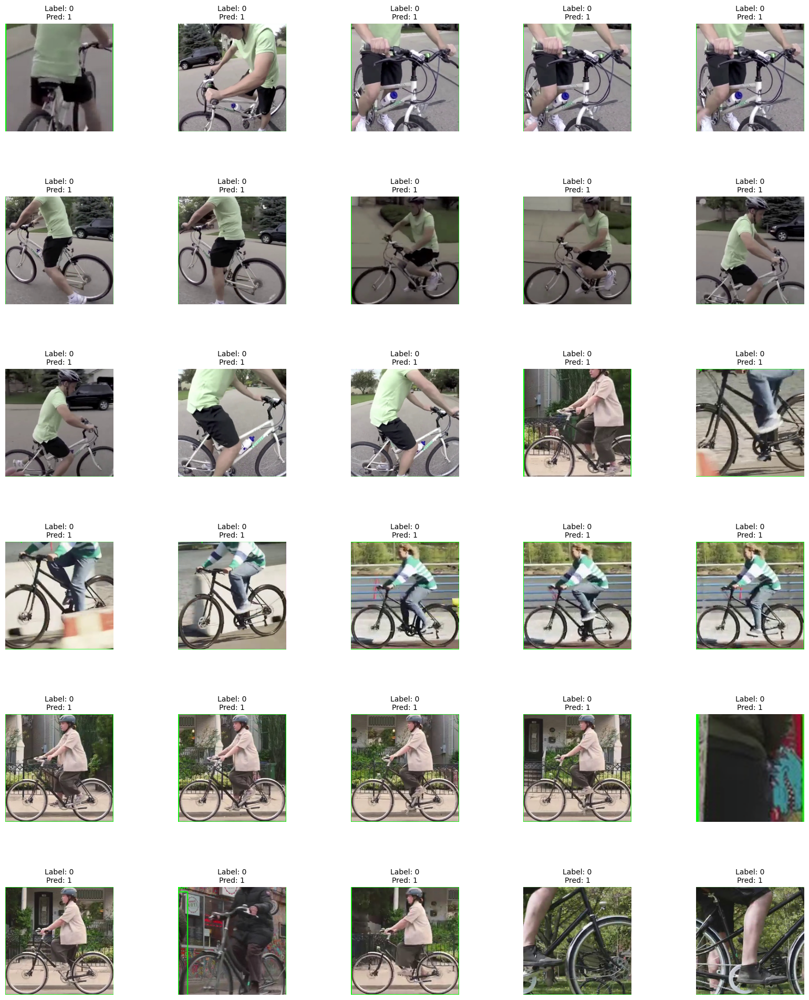

In [40]:
yoloPoseModel = YOLO('F:/UT_MIE/MIE1517/Project/yolov8n-pose.pt') 

PoseNetCNN_model = PoseNetCNN1(lrelu_tr=0.1, dropout_cnn=0.2, dropout_mlp=0.2)
# # data parallel
# # model = nn.DataParallel(model, device_ids=[0, 1])
PoseNetCNN_model.to(torch.device("cuda:0"))

train_PoseNetCNN(train_dataset=train_dataset,
            val_dataset=val_dataset,
            model=PoseNetCNN_model,
            num_epochs=10,
            bsz=128,
            lr=0.0001,
            patience=3,
            PoseNetModel=yoloPoseModel,
            use_gpu=True,
            plot_=True,
            model_dir='models')

curr device: cuda


Epoch 1/10: 100%|██████████| 59/59 [00:24<00:00,  2.36it/s]


Epoch 1: Train Loss: 0.5434, Acc: 0.7103, Precision: 0.6690, Recall: 0.8248, F1: 0.7388
         Val Loss: 0.7189, Acc: 0.6278, Precision: 0.5742, Recall: 0.8732, F1: 0.6928


Epoch 2/10: 100%|██████████| 59/59 [00:24<00:00,  2.37it/s]


Epoch 2: Train Loss: 0.2516, Acc: 0.8989, Precision: 0.8888, Recall: 0.9104, F1: 0.8995
         Val Loss: 0.8419, Acc: 0.6038, Precision: 0.5611, Recall: 0.8061, F1: 0.6617
no improvement in val loss for 1 epochs.


Epoch 3/10: 100%|██████████| 59/59 [00:24<00:00,  2.37it/s]


Epoch 3: Train Loss: 0.1857, Acc: 0.9269, Precision: 0.9289, Recall: 0.9236, F1: 0.9262
         Val Loss: 0.7203, Acc: 0.6653, Precision: 0.6323, Recall: 0.7256, F1: 0.6758
no improvement in val loss for 2 epochs.


Epoch 4/10: 100%|██████████| 59/59 [00:24<00:00,  2.39it/s]


Epoch 4: Train Loss: 0.1145, Acc: 0.9574, Precision: 0.9568, Recall: 0.9574, F1: 0.9571
         Val Loss: 0.8674, Acc: 0.6589, Precision: 0.5891, Recall: 0.9598, F1: 0.7301
no improvement in val loss for 3 epochs.
patient exceeded, early stop triggered at epoch 3

Best val corr observed at 3: 0.6652989449003517
Best val loss observed at 1: 0.7188969435436385
Best val F1 observed at 4: 0.7300556586270872


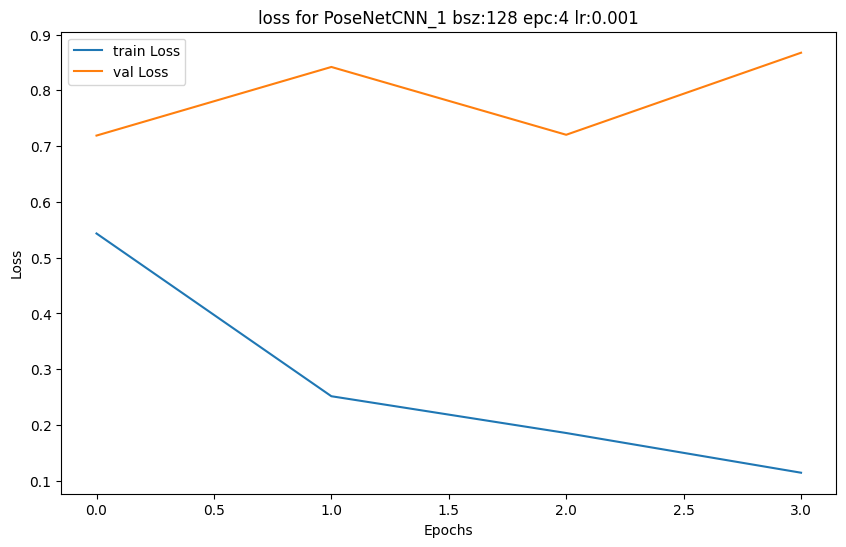

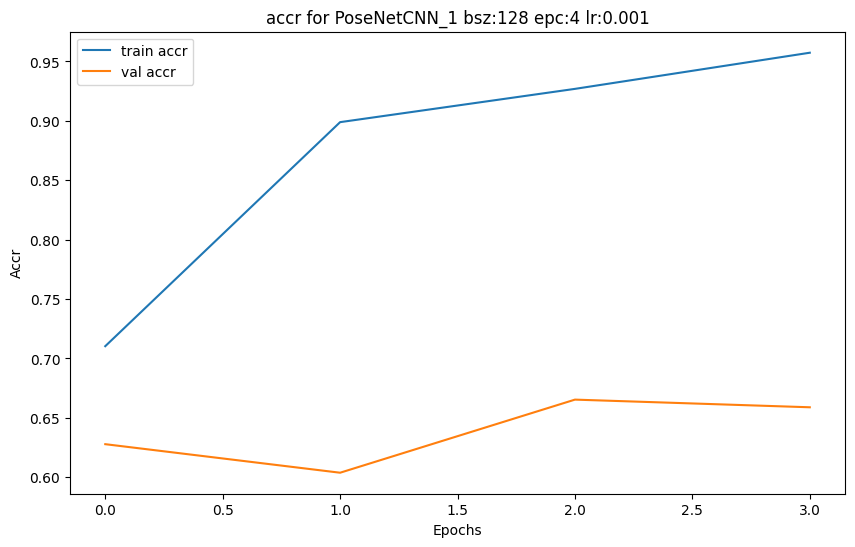

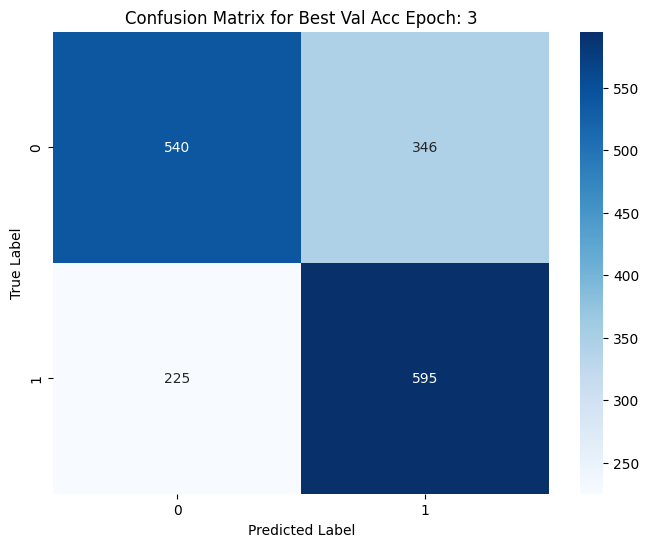

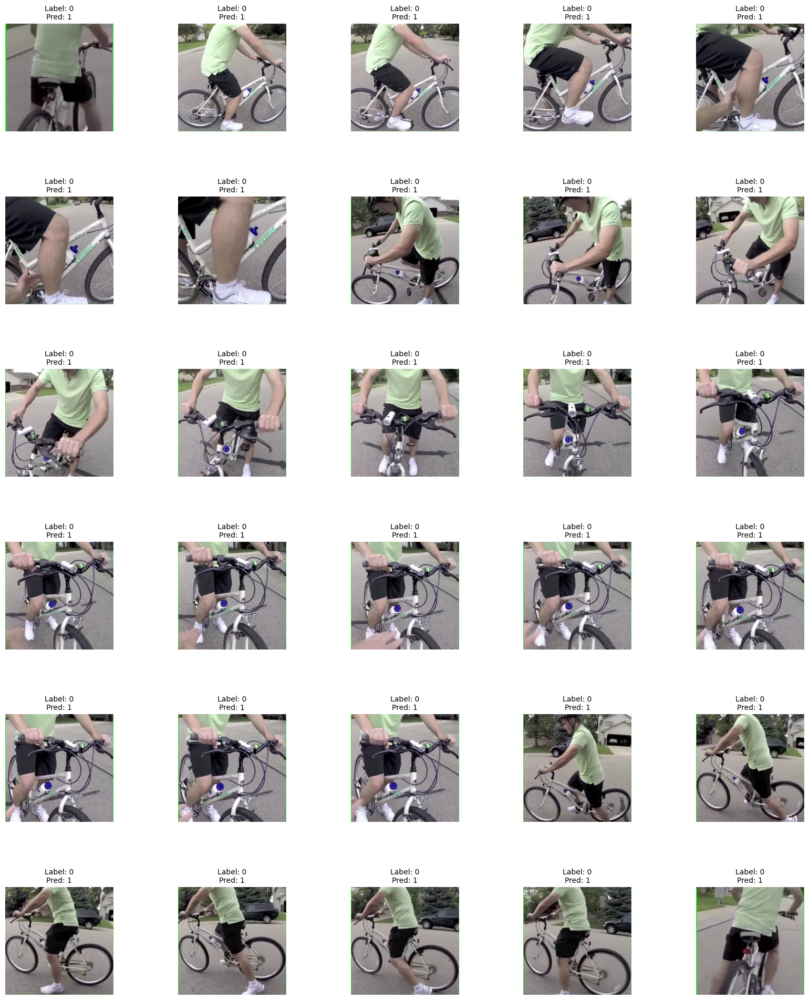

In [41]:
yoloPoseModel = YOLO('F:/UT_MIE/MIE1517/Project/yolov8n-pose.pt') 

PoseNetCNN_model = PoseNetCNN1(lrelu_tr=0.1, dropout_cnn=0.2, dropout_mlp=0.2)
# # data parallel
# # model = nn.DataParallel(model, device_ids=[0, 1])
PoseNetCNN_model.to(torch.device("cuda:0"))

train_PoseNetCNN(train_dataset=train_dataset,
            val_dataset=val_dataset,
            model=PoseNetCNN_model,
            num_epochs=10,
            bsz=128,
            lr=0.001,
            patience=3,
            PoseNetModel=yoloPoseModel,
            use_gpu=True,
            plot_=True,
            model_dir='models')

curr device: cuda


Epoch 1/10: 100%|██████████| 234/234 [00:29<00:00,  8.02it/s]


Epoch 1: Train Loss: 0.3555, Acc: 0.8363, Precision: 0.8077, Recall: 0.8799, F1: 0.8423
         Val Loss: 0.9418, Acc: 0.6172, Precision: 0.5682, Recall: 0.8488, F1: 0.6807


Epoch 2/10: 100%|██████████| 234/234 [00:28<00:00,  8.16it/s]


Epoch 2: Train Loss: 0.1706, Acc: 0.9378, Precision: 0.9341, Recall: 0.9412, F1: 0.9376
         Val Loss: 0.7144, Acc: 0.7157, Precision: 0.6784, Recall: 0.7768, F1: 0.7243


Epoch 3/10: 100%|██████████| 234/234 [00:28<00:00,  8.16it/s]


Epoch 3: Train Loss: 0.1146, Acc: 0.9619, Precision: 0.9597, Recall: 0.9638, F1: 0.9618
         Val Loss: 0.7195, Acc: 0.7040, Precision: 0.6347, Recall: 0.9049, F1: 0.7461
no improvement in val loss for 1 epochs.


Epoch 4/10: 100%|██████████| 234/234 [00:28<00:00,  8.10it/s]


Epoch 4: Train Loss: 0.0809, Acc: 0.9721, Precision: 0.9704, Recall: 0.9735, F1: 0.9720
         Val Loss: 2.5695, Acc: 0.6067, Precision: 0.5506, Recall: 0.9878, F1: 0.7071
no improvement in val loss for 2 epochs.


Epoch 5/10: 100%|██████████| 234/234 [00:28<00:00,  8.17it/s]


Epoch 5: Train Loss: 0.0661, Acc: 0.9769, Precision: 0.9768, Recall: 0.9768, F1: 0.9768
         Val Loss: 1.6407, Acc: 0.6630, Precision: 0.5939, Recall: 0.9451, F1: 0.7294
no improvement in val loss for 3 epochs.
patient exceeded, early stop triggered at epoch 4

Best val corr observed at 2: 0.7157092614302462
Best val loss observed at 2: 0.7144097353297251
Best val F1 observed at 3: 0.7461035696329814


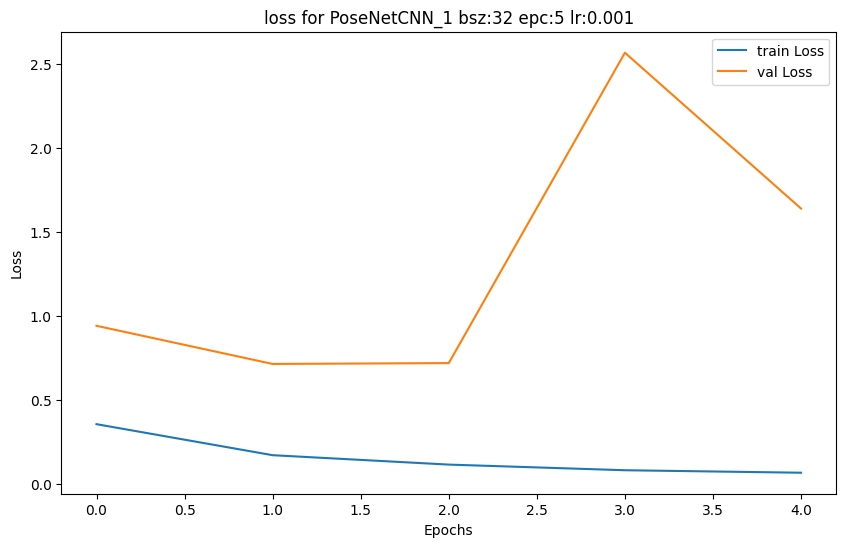

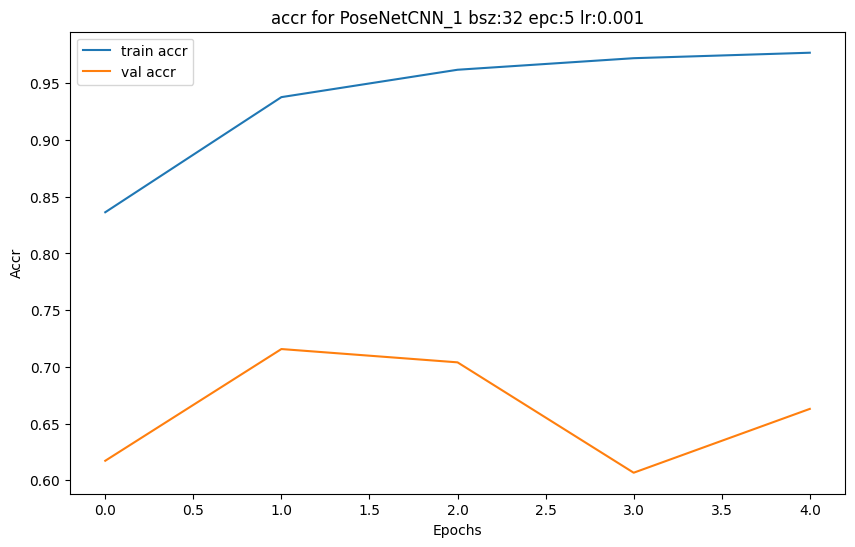

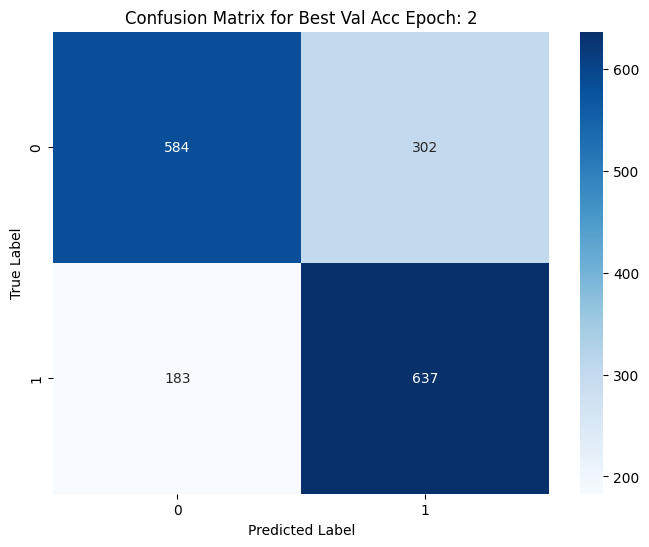

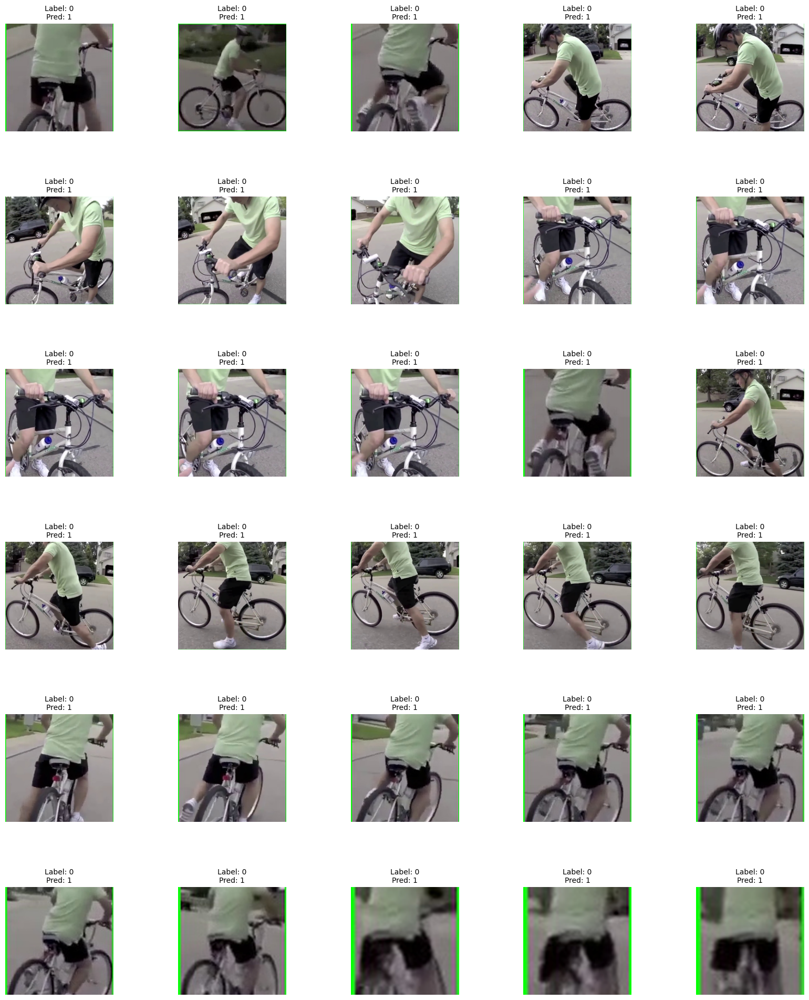

In [42]:
yoloPoseModel = YOLO('F:/UT_MIE/MIE1517/Project/yolov8n-pose.pt') 

PoseNetCNN_model = PoseNetCNN1(lrelu_tr=0.1, dropout_cnn=0.2, dropout_mlp=0.2)
# # data parallel
# # model = nn.DataParallel(model, device_ids=[0, 1])
PoseNetCNN_model.to(torch.device("cuda:0"))

train_PoseNetCNN(train_dataset=train_dataset,
            val_dataset=val_dataset,
            model=PoseNetCNN_model,
            num_epochs=10,
            bsz=32,
            lr=0.001,
            patience=3,
            PoseNetModel=yoloPoseModel,
            use_gpu=True,
            plot_=True,
            model_dir='models')

In [45]:
class PoseNetResnet_Drop(nn.Module):
    def __init__(self, num_keypoints=17, num_classes=1, lrelu_tr=0.1, pretrained=True, dropout_rate=0.2):
        super(PoseNetResnet_Drop, self).__init__()
        self.name = "PoseNetResnet_Drop"

        # Load a pretrained ResNet18 model
        self.resnet = models.resnet18(pretrained=pretrained)
        
        # Remove the fully connected layer of ResNet18
        self.resnet = nn.Sequential(*(list(self.resnet.children())[:-2]))
        
        # MLP for processing keypoints, with dropout after activations
        self.yoloMLP = nn.Sequential(
            nn.Linear(num_keypoints * 2, 128),
            nn.LeakyReLU(lrelu_tr),
            nn.Dropout(dropout_rate),  # Adding dropout here
            nn.Linear(128, 64),
            nn.LeakyReLU(lrelu_tr),
            nn.Dropout(dropout_rate)  # And here
        )
        
        # Combined MLP with dropout after activations
        self.combinedMLP = nn.Sequential(
            nn.Linear(512 * 7 * 7 + 64, 1024),
            nn.ReLU(),
            nn.Dropout(dropout_rate),  # Adding dropout here
            nn.Linear(1024, 256),
            nn.ReLU(),
            nn.Dropout(dropout_rate),  # And here
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.Dropout(dropout_rate),  # And also here
            nn.Linear(128, num_classes)
        )

    def forward(self, x, keypoints):
        # Process images through the ResNet18 model
        x = self.resnet(x)
        x = torch.flatten(x, 1)

        # Process keypoints through the yoloMLP
        keypoints = keypoints.view(keypoints.size(0), -1)
        yoloMLP_out = self.yoloMLP(keypoints)

        # Concatenate features
        concat_features = torch.cat((x, yoloMLP_out), dim=1)

        # Final classification through the combined MLP
        output = self.combinedMLP(concat_features)

        return output

c:\Users\Ningxin Cynthia Li\anaconda3\envs\MIE\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Ningxin Cynthia Li\anaconda3\envs\MIE\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


curr device: cuda


Epoch 1/10: 100%|██████████| 117/117 [00:27<00:00,  4.30it/s]


Epoch 1: Train Loss: 0.3126, Acc: 0.9019, Precision: 0.8948, Recall: 0.9093, F1: 0.9020
         Val Loss: 2.6884, Acc: 0.6706, Precision: 0.5936, Recall: 0.9976, F1: 0.7443


Epoch 2/10: 100%|██████████| 117/117 [00:26<00:00,  4.36it/s]


Epoch 2: Train Loss: 0.0799, Acc: 0.9728, Precision: 0.9720, Recall: 0.9733, F1: 0.9726
         Val Loss: 0.8289, Acc: 0.7767, Precision: 0.8927, Recall: 0.6085, F1: 0.7237


Epoch 3/10: 100%|██████████| 117/117 [00:26<00:00,  4.36it/s]


Epoch 3: Train Loss: 0.0588, Acc: 0.9787, Precision: 0.9769, Recall: 0.9803, F1: 0.9786
         Val Loss: 3.0967, Acc: 0.6547, Precision: 0.5821, Recall: 0.9988, F1: 0.7355
no improvement in val loss for 1 epochs.


Epoch 4/10: 100%|██████████| 117/117 [00:26<00:00,  4.33it/s]


Epoch 4: Train Loss: 0.0688, Acc: 0.9790, Precision: 0.9813, Recall: 0.9762, F1: 0.9788
         Val Loss: 1.5257, Acc: 0.6911, Precision: 0.6179, Recall: 0.9366, F1: 0.7445
no improvement in val loss for 2 epochs.


Epoch 5/10: 100%|██████████| 117/117 [00:26<00:00,  4.37it/s]


Epoch 5: Train Loss: 0.0407, Acc: 0.9861, Precision: 0.9844, Recall: 0.9876, F1: 0.9860
         Val Loss: 0.3486, Acc: 0.8611, Precision: 0.8955, Recall: 0.8049, F1: 0.8478


Epoch 6/10: 100%|██████████| 117/117 [00:26<00:00,  4.36it/s]


Epoch 6: Train Loss: 0.0303, Acc: 0.9905, Precision: 0.9898, Recall: 0.9911, F1: 0.9904
         Val Loss: 1.2790, Acc: 0.7761, Precision: 0.7013, Recall: 0.9305, F1: 0.7998
no improvement in val loss for 1 epochs.


Epoch 7/10: 100%|██████████| 117/117 [00:26<00:00,  4.37it/s]


Epoch 7: Train Loss: 0.0293, Acc: 0.9916, Precision: 0.9914, Recall: 0.9916, F1: 0.9915
         Val Loss: 4.1324, Acc: 0.7011, Precision: 0.6220, Recall: 0.9634, F1: 0.7560
no improvement in val loss for 2 epochs.


Epoch 8/10: 100%|██████████| 117/117 [00:26<00:00,  4.35it/s]


Epoch 8: Train Loss: 0.0383, Acc: 0.9886, Precision: 0.9879, Recall: 0.9892, F1: 0.9885
         Val Loss: 2.8511, Acc: 0.6729, Precision: 0.5959, Recall: 0.9927, F1: 0.7447
no improvement in val loss for 3 epochs.
patient exceeded, early stop triggered at epoch 7

Best val corr observed at 5: 0.8610785463071512
Best val loss observed at 5: 0.34864094480872154
Best val F1 observed at 5: 0.8477842003853564


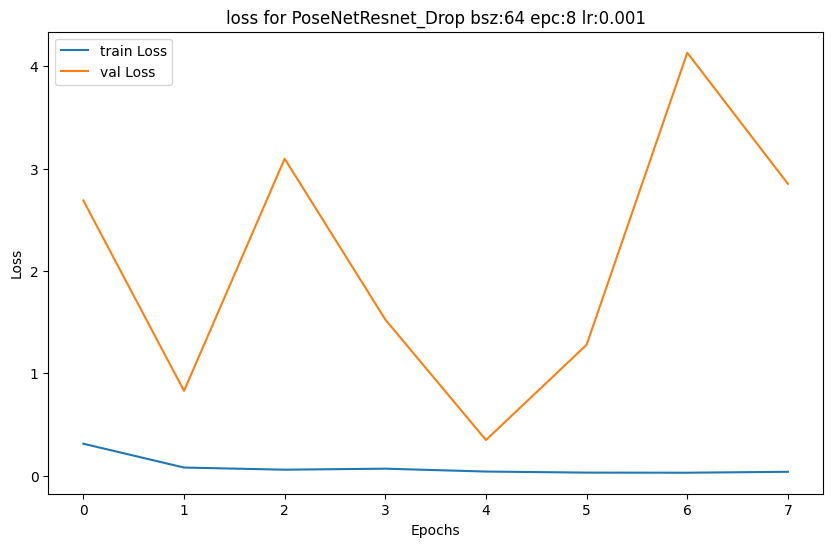

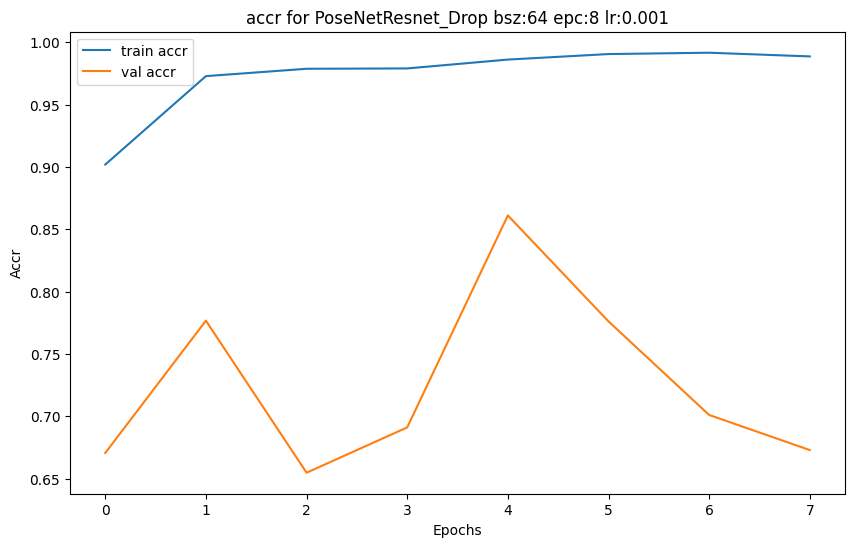

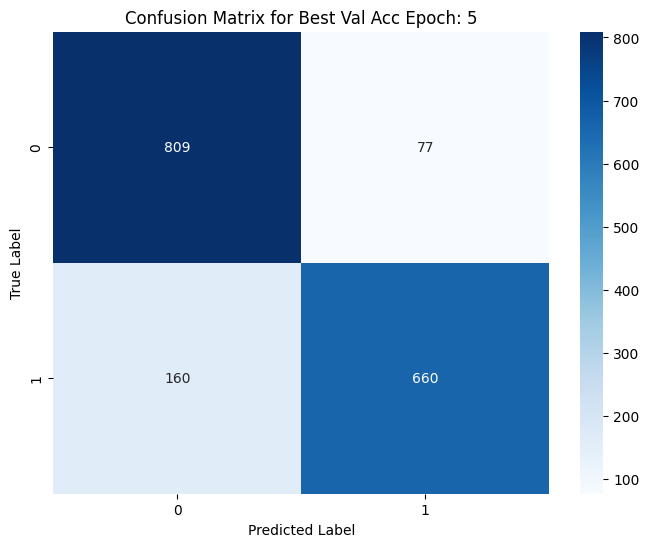

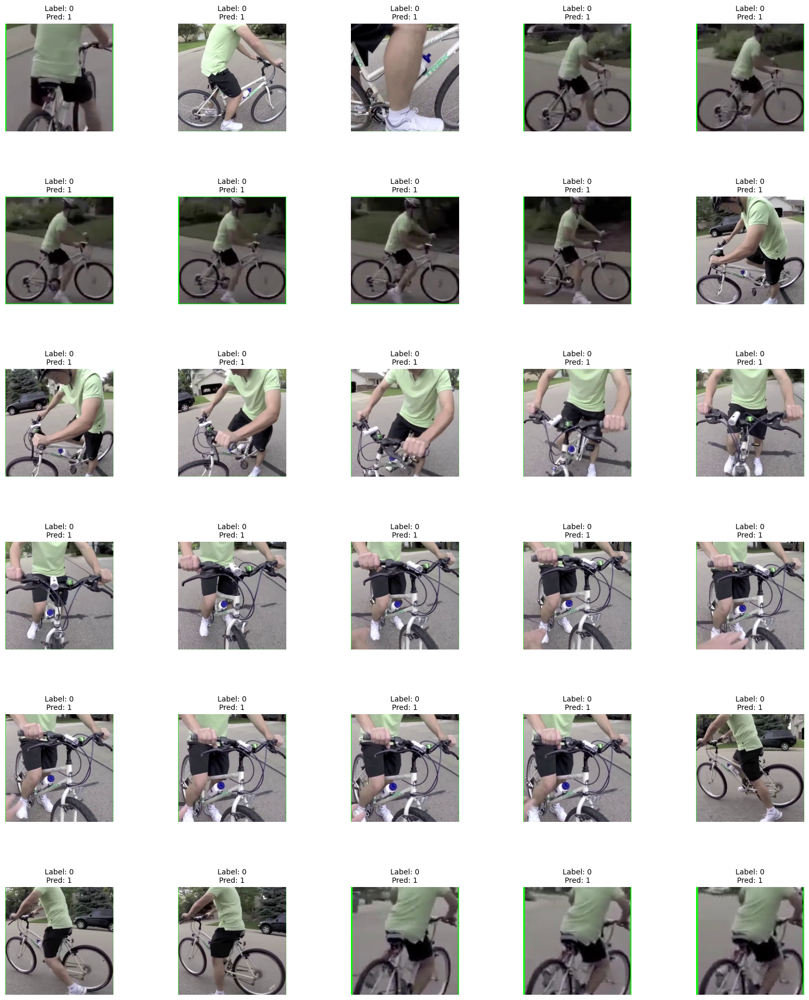

In [46]:
yoloPoseModel = YOLO('F:/UT_MIE/MIE1517/Project/yolov8n-pose.pt') 

PoseNetCNN_model = PoseNetResnet_Drop(dropout_rate=0.2)

PoseNetCNN_model.to(torch.device("cuda:0"))

train_PoseNetCNN(train_dataset=train_dataset,
            val_dataset=val_dataset,
            model=PoseNetCNN_model,
            num_epochs=10,
            bsz=64,
            lr=0.001,
            patience=3,
            PoseNetModel=yoloPoseModel,
            use_gpu=True,
            plot_=True,
            model_dir='models')

# Test Models
## Testset

In [25]:
def get_accuracy(model, data_loader, PoseNetModel):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)
    model.eval()
    
    correct, total = 0, 0
    misclassified_samples = []
    label_list, pred_list = [], []
    with torch.no_grad():
        for inputs, labels in data_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            res = PoseNetModel(inputs, verbose=False)
            res_keypoints = torch.stack([i.keypoints[0].xy if i.keypoints[0].conf!=None else torch.zeros(1,17,2).to(device) for i in res ]).squeeze(1)

            ################
            mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1).to(device)
            std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1).to(device)
            inputs = (inputs - mean) / std
            
            outputs = model(inputs, res_keypoints)  # Normalize inputs
            preds = torch.round(torch.sigmoid(outputs))
            
            correct += (preds.squeeze(1) == labels).sum().item()
            total += labels.size(0)

            label_list.extend(labels.cpu().numpy())
            pred_list.extend(preds.squeeze(1).detach().cpu().numpy())

            misclassified = (preds.squeeze(1) != labels)
            for i, mis in enumerate(misclassified):
                if mis:
                    misclassified_samples.append((inputs[i].cpu(), labels[i].cpu(), preds[i].cpu()))

        # Recalculate or retrieve predictions for the best_acc_epoch if necessary
        cm = confusion_matrix(label_list, pred_list)
        plt.figure(figsize=(8, 6))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=[0, 1], yticklabels=[0, 1])
        plt.title(f'Confusion Matrix for Test Set')
        plt.ylabel('True Label')
        plt.xlabel('Predicted Label')
        plt.show()

        show_misclassified_images(misclassified_samples)

    return correct / total


In [26]:
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

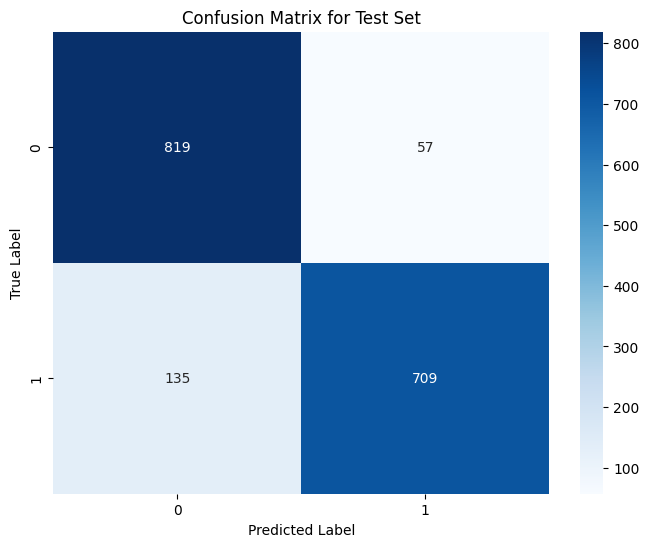

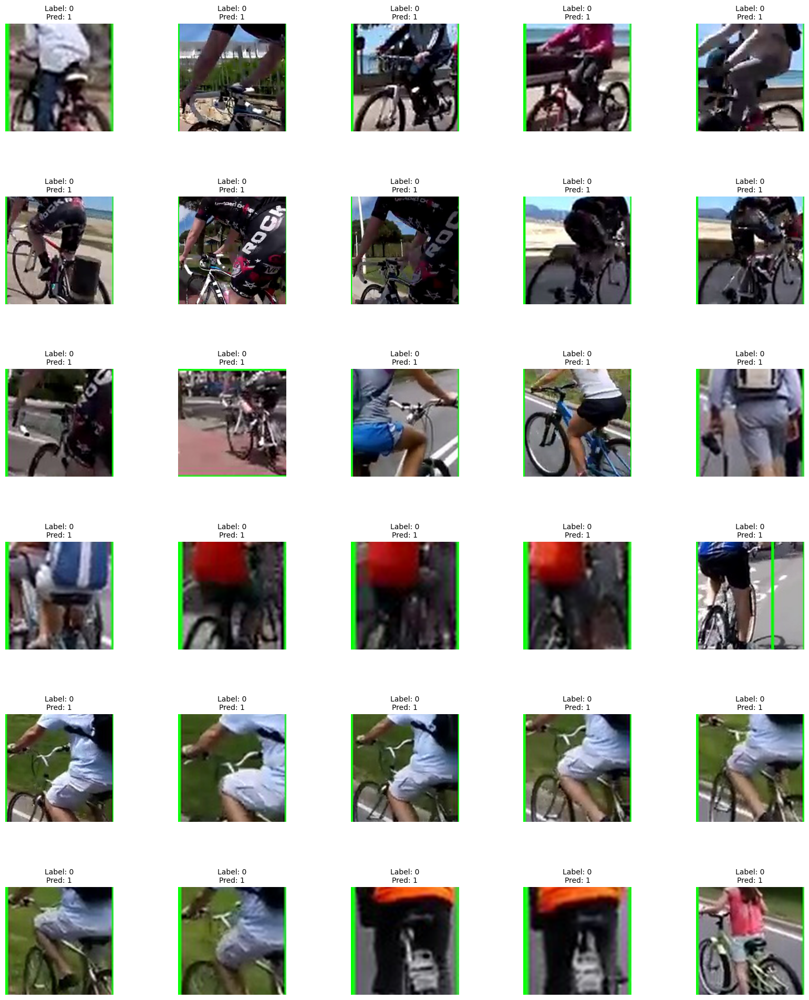

The test accuracy of best model is:  0.8883720930232558


In [29]:
yoloPoseModel = YOLO('F:/UT_MIE/MIE1517/Project/yolov8n-pose.pt') 
best_model = PoseNetCNN()
model_dir = 'models'
best_filename = "PoseNetCNN_best.pth"
best_path = os.path.join(model_dir, best_filename)
best_model.load_state_dict(torch.load(best_path))

# Test on the unseen test dataset
test_acc = get_accuracy(best_model, test_loader, yoloPoseModel)
print("The test accuracy of best model is: ", test_acc)

c:\Users\Ningxin Cynthia Li\anaconda3\envs\MIE\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Ningxin Cynthia Li\anaconda3\envs\MIE\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


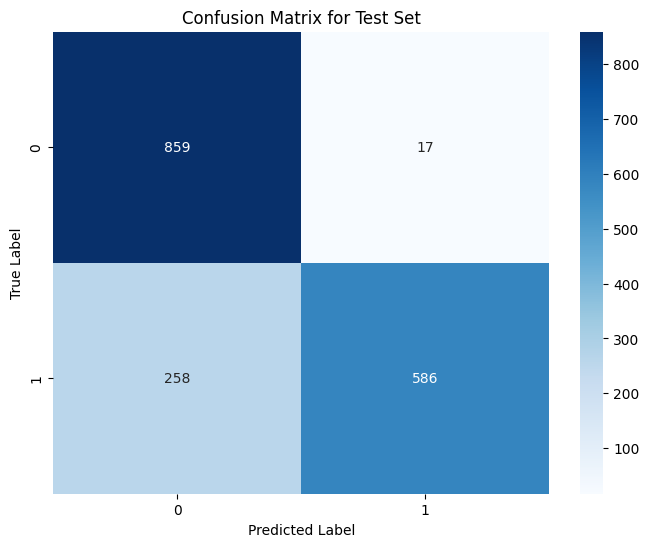

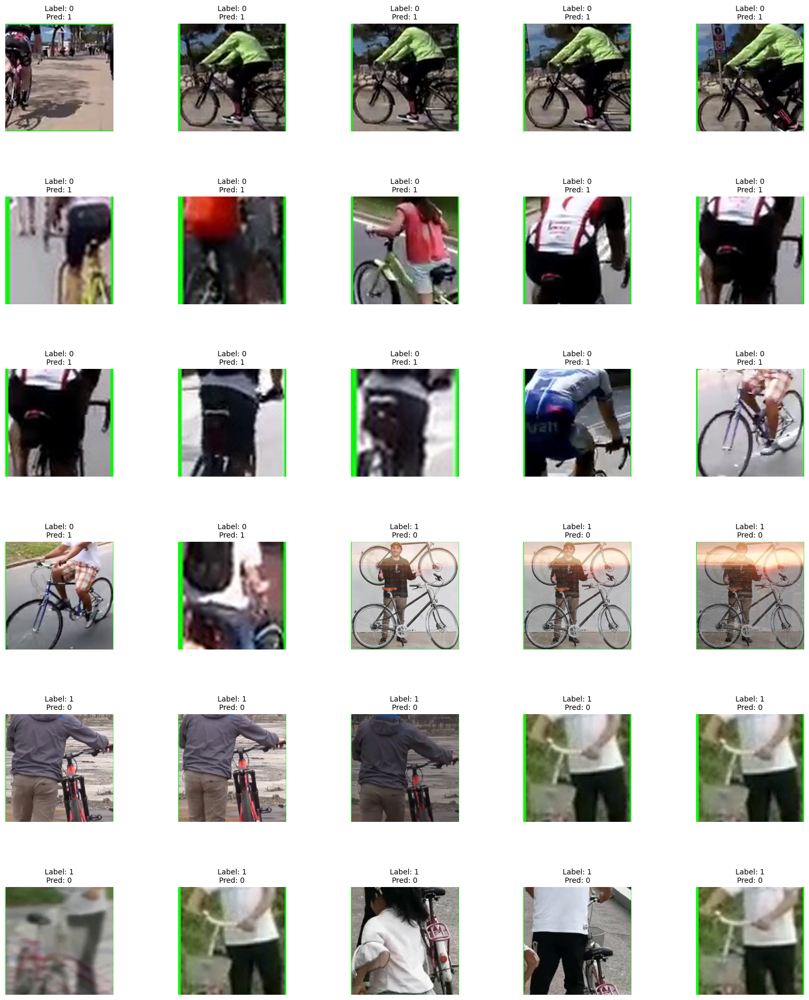

The test accuracy of best model is:  0.8401162790697675


In [30]:
yoloPoseModel = YOLO('F:/UT_MIE/MIE1517/Project/yolov8n-pose.pt') 
best_model = PoseNetResnet()
model_dir = 'models'
best_filename = 'PoseNetResnet_best.pth'
best_path = os.path.join(model_dir, best_filename)
best_model.load_state_dict(torch.load(best_path))

# Test on the unseen test dataset
test_acc = get_accuracy(best_model, test_loader, yoloPoseModel)
print("The test accuracy of best model is: ", test_acc)

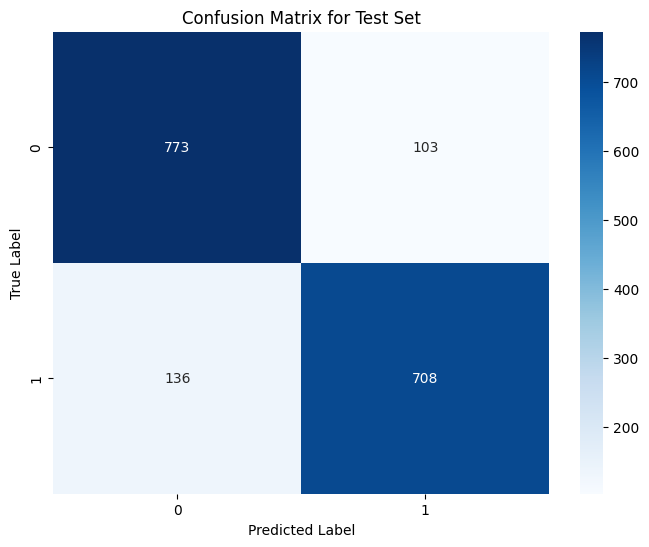

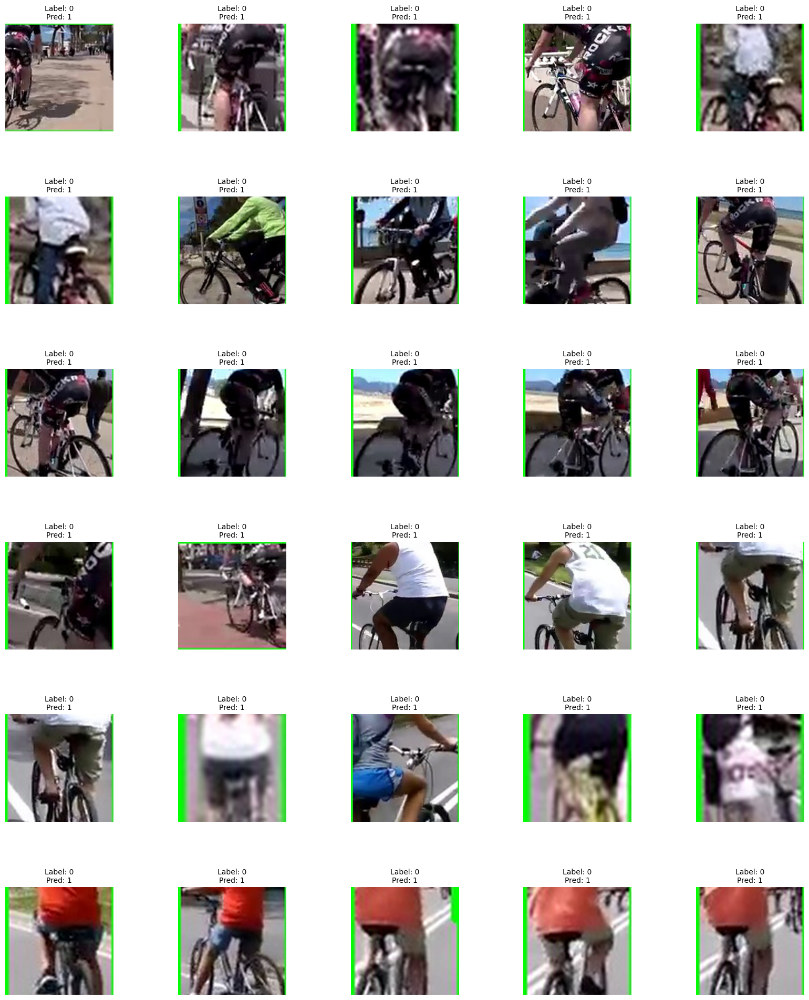

The test accuracy of best model is:  0.861046511627907


In [43]:
yoloPoseModel = YOLO('F:/UT_MIE/MIE1517/Project/yolov8n-pose.pt') 
best_model = PoseNetCNN1(lrelu_tr=0.1, dropout_cnn=0.2, dropout_mlp=0.2)
model_dir = 'models'
best_filename = "PoseNetCNN_1_best.pth"
best_path = os.path.join(model_dir, best_filename)
best_model.load_state_dict(torch.load(best_path))

# Test on the unseen test dataset
test_acc = get_accuracy(best_model, test_loader, yoloPoseModel)
print("The test accuracy of best model is: ", test_acc)

## Integrated system

In [ ]:
"""
The function cyclist_detect_system serves as our integrated system that takes in a
raw video and performs cyclist biking status classification. The annotated frames
and videos will be stored in a folder.

Note that in the annotated videos, the bounding boxes are cyclist bounding boxes
and the green dots are the 17 keypoints on human stem. We highlight the riding
class with red bounding box and green bouding box for unride.


"""
from PIL import Image
import torchvision.transforms as transforms

def resize_and_pad(img_size):
    return transforms.Compose([
        transforms.Resize(img_size, interpolation=transforms.InterpolationMode.BILINEAR),
        transforms.CenterCrop(img_size),
        transforms.ToTensor(),
        # Optional: Apply normalization if needed
        # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])

def pad_to_square(img, fill=0):
    max_size = max(img.size)
    padding = [0, 0, max_size - img.size[0], max_size - img.size[1]]  # Calculate padding
    return transforms.Pad(padding, fill=fill)(img)

def cyclist_detect_system(data_home_dir, img_out_dir, vid_in_dir, model, cls, PoseNetModel,PoseNetCNN, yolo_imgsz=640, out_fps=3,vid_out_dir=None, box_conf_tr=0, device="cpu"):

    ####################
    inference_transform = transforms.Compose([
            transforms.Lambda(lambda img: pad_to_square(img, fill=0)),
            resize_and_pad((224, 224)),
            # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
        ])

    PoseNetModel = PoseNetModel.to(device)
    PoseNetCNN  = PoseNetCNN.to(device)
    #####################

    vid_in_name,vid_in_ext = os.path.splitext(os.path.basename(vid_in_dir))

    # load video and start recieving output
    cap = cv2.VideoCapture(vid_in_dir)
    print(f"processing vid: {vid_in_dir}")
    if not cap.isOpened():
        print(f"cap is not opened: status-{cap.isOpened()}")
        sys.exit()
    # get specs of video
    fps = cap.get(cv2.CAP_PROP_FPS)
    # print("here")
    frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    # extract part of the frames only to save computation and storage
    skip_frames = int(fps / out_fps)
    ## output to mp4
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    vid_out_dir = os.path.join(img_out_dir ,vid_in_name) # output video to same folder as frames
    os.makedirs(vid_out_dir, exist_ok=True)
    video_out = cv2.VideoWriter(os.path.join(vid_out_dir,f'res_{vid_in_name}{vid_in_ext}'), fourcc, out_fps, (frame_width, frame_height))

    #### process each iamge with yolo
    frame_id = 0

    while cap.isOpened():
        ret,frame = cap.read()
        # print("cap ret frame read")
        if ret:
            # skip frames
            if frame_id % skip_frames == 0:
                frame_rgb = frame # cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
                # save curr frame
                # cv2.imwrite(f'{output_path}/{frame_id}.jpg', frame_rgb)

                # inference
                results = model([frame_rgb], imgsz=yolo_imgsz, verbose=False)
                #
                # out.write(results.numpy())
                # #
                for img_index, result in enumerate(results):
                    frame_folder_dir  = f'{vid_in_name}/res_img_{img_index}_frame_{frame_id}'
                    frame_output_filename = f'{cls}_res_yolo_vid_{vid_in_name}_img_{img_index}_fid_{frame_id}.jpg'
                    frame_folder_dir = os.path.join(img_out_dir, frame_folder_dir)
                    os.makedirs(frame_folder_dir, exist_ok=True)

                    # print(img_index)
                    # save yolo annoated result
                    result.save(filename=f"{frame_folder_dir}/{frame_output_filename}")
                    result_array = result.plot(labels=False, probs=False, boxes=False)
                    # retireve all the bbox predicted by yolo, here, only classes labeled as human or bike are gathered
                    # these resultes are stored in a dict which will then be further processed
                    person_bbox_list, bike_bbox_list = [],[]
                    bbox_cls_dict = result.names
                    boxes_labs = result.boxes.cls.tolist()
                    boxes_conf = result.boxes.conf.tolist()
                    for box_id, (box, box_label, box_conf) in enumerate(zip(result.boxes.xyxy, boxes_labs,boxes_conf)):
                        bbox_path=f"{frame_folder_dir}/box_id_{box_id}_{bbox_cls_dict[box_label]}.jpg"
                        x1,y1,x2,y2 = [int(_) for _ in box.tolist()]
                        x1, y1 = max(x1, 0), max(y1, 0)
                        x2, y2 = min(x2, frame_width), min(y2, frame_height)
                        # print(x1,y1,x2,y2)
                        # cropped_img = frame_rgb[y1:y2, x1:x2]
                        # cv2.imwrite(bbox_path, cropped_img)
                        # store the current bounding box
                        #################################
                        if box_conf>box_conf_tr:
                            pb_bbox_path=f"{frame_folder_dir}/{cls}_res_cropbp_vid_{vid_in_name}_img_{img_index}_fid_{frame_id}_bbox_{box_id}.jpg"
                            pb_bbox_img = frame_rgb[y1:y2, x1:x2]
                            cv2.imwrite(pb_bbox_path, pb_bbox_img)

                            #
                            pb_bbox_img = cv2.cvtColor(pb_bbox_img, cv2.COLOR_BGR2RGB)
                            #
                            device="cuda"
                            pb_bbox_img_tran = inference_transform(Image.fromarray(pb_bbox_img)).unsqueeze(0).to(device)
                            PoseNetCNN.eval()
                            with torch.no_grad():
                                res = PoseNetModel(pb_bbox_path, verbose=False)
                                if res[0].keypoints.conf!=None:
                                    res_keypoints_np = res[0].keypoints[0].xy[0]
                                    res_keypoints = torch.tensor(res[0].keypoints.xy[0].unsqueeze(0))   #torch.stack([i.keypoints.xy if i.keypoints.conf!=None else torch.zeros(1,17,2).to(device) for i in res ]).squeeze(1).to(device)

                                    keypoints_large_img = [(x + x1, y + y1) for (x, y) in res_keypoints_np if not x==y==0.0]

                                    for (x, y) in keypoints_large_img:
                                        cv2.circle(frame_rgb, (int(x), int(y)), radius=3, color=(0, 255, 0), thickness=-1)
                                        cv2.circle(result_array, (int(x), int(y)), radius=3, color=(0, 255, 0), thickness=-1)
                                else:
                                    res_keypoints = torch.zeros(1,17,2).to(device)
                                    # print("reach 0")

                                ################ normalize the input image
                                mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1).to(device)
                                std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1).to(device)
                                pb_bbox_img_tran = (pb_bbox_img_tran - mean) / std
                                ################

                                curr_bbox_outputs = PoseNetCNN(pb_bbox_img_tran, res_keypoints)
                                preds = torch.round(torch.sigmoid(curr_bbox_outputs))

                                #
                                label={0:"ride",1:"unride"}[preds.item()]
                                color_ = {0:(0, 0, 255), 1:(0, 255, 0)}[preds.item()]
                                cv2.rectangle(result_array, (x1, y1), (x2, y2), color_, 2)
                                cv2.putText(result_array, label, (x1, max(y1 - 10, 0)), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color_, 2)

                        #################################



                    video_out.write(result_array) # f'{cls}_res_img_{img_index}_fid_{frame_id}.jpg'
                    cv2.imwrite(f"{frame_folder_dir}/{cls}_res_yolobp_vid_{vid_in_name}_img_{img_index}_fid_{frame_id}.jpg", result_array)

            frame_id += 1
        else:
            break

    # print("here end")
    cap.release()
    video_out.release()

In [ ]:
# This code serves as our integrated system, this takes in all the raw videos in
# a folder and perform cyclist riding status classification. The results will be
# stored in a seperate file containing the results for each frame and the anntated
# video.

objDetectModel = YOLO('/home/yuliang/1517proj/ultralytics/checkpoints/yolov8n_e46_v0.pt')
PoseNetModel = YOLO('/home/yuliang/1517proj/ultralytics/checkpoints/yolov8n-pose.pt')
PoseNetCNN_ = PoseNetCNN3() #torch.load('/home/yuliang/1517_proj/ultralytics/checkpoint/PoseNetResnet_96') #PoseNetResnet_96
PoseNetCNN_.load_state_dict(torch.load('/home/yuliang/1517proj/ultralytics/checkpoints/PoseNetCNN3/PoseNetCNN3_best.pth'))
# PoseNetCNN = torch.load('/home/yuliang/1517_proj/ultralytics/checkpoint/PoseNetCNN/PoseNetCNN_best.pth')

#
cls_list=['test']
# cls=cls_list[0]
for cls in cls_list:
    task_name = "bike_data"
    data_home_dir="/home/yuliang/1517proj/ultralytics/datasets/test_vid"
    img_out_dir=f"/home/yuliang/1517proj/ultralytics/datasets/test_vid/v1/{task_name}_img/"
    vid_out_dir=f"/home/yuliang/1517proj/ultralytics/datasets/test_vid/v1/{task_name}_vid/"
    os.makedirs(img_out_dir, exist_ok=True)
    os.makedirs(vid_out_dir, exist_ok=True)

    raw_data_dir = f"/home/yuliang/1517proj/ultralytics/datasets/test_vid"
    for file in os.listdir(raw_data_dir):
        if file.endswith('.mp4'):
            vid_in_dir = os.path.join(raw_data_dir, file)
            cyclist_detect_system(data_home_dir, img_out_dir, vid_in_dir, device="cuda:0",
                               model=objDetectModel,
                               PoseNetModel=PoseNetModel,
                               PoseNetCNN=PoseNetCNN_,
                                 cls=cls, yolo_imgsz=640, out_fps=5,box_conf_tr=0.5 )